In [2]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import find_peaks
import pandas as pd
import seaborn as sb
import matplotlib.pyplot as plt # we only need pyplot
from scipy.ndimage import median_filter
from scipy.signal import butter,filtfilt,sosfilt,medfilt
from scipy import signal
from scipy.special import softmax
from array import array
from matplotlib.patches import Rectangle
from scipy.signal import argrelextrema
import heartpy as hp
import neurokit2 as nk
from scipy.interpolate import interp1d
sb.set() # set the default Seaborn style for graphics

In [3]:
import os
import pandas as pd
import numpy as np

def load_txt_file(file_path):
    """Loads a .txt file and returns a NumPy array of its contents."""
    return np.loadtxt(file_path)

def stitch_ppg_segments(directory, excel_file, sheet_name, output_dir):
    """Reads and stitches three PPG signal segments per subject ID."""
    
    # Load the subject IDs from the Excel file
    df_ids = pd.read_excel(excel_file, sheet_name=sheet_name)
    subject_ids = df_ids.iloc[1:, 1].dropna().astype(int).tolist()  # Extract valid subject IDs
    
    # Ensure output directory exists
    os.makedirs(output_dir, exist_ok=True)
    
    stitched_data = {}
    
    # Iterate through subject IDs and stitch corresponding segments
    for subject_id in subject_ids:
        segment_files = [os.path.join(directory, f"{subject_id}_{i}.txt") for i in range(1, 4)]
        
        if all(os.path.exists(f) for f in segment_files):
            # Load and concatenate the three segments
            stitched_signal = np.concatenate([load_txt_file(f) for f in segment_files])
            
            # Save the stitched signal
            output_file = os.path.join(output_dir, f"{subject_id}_stitched.txt")
            np.savetxt(output_file, stitched_signal)
            stitched_data[subject_id] = stitched_signal
            print(f"Stitched and saved: {output_file}")
        else:
            print(f"Missing segments for subject {subject_id}, skipping...")
    
    return stitched_data

In [4]:
directory = "C:/Users/Nicholas Sudiyanto G/Downloads/5459299/PPG-BP Database/Data File/0_subject"  # Folder containing the PPG segment files
excel_file = "C:/Users/Nicholas Sudiyanto G/Downloads/5459299/PPG-BP Database/Data File/PPG-BP dataset.xlsx"  # Path to the Excel file
sheet_name = "cardiovascular dataset"
output_dir = "C:/Users/Nicholas Sudiyanto G/Downloads/5459299/PPG-BP Database/Data File/stitched_signals"

stitched_signals = stitch_ppg_segments(directory, excel_file, sheet_name, output_dir)

Stitched and saved: C:/Users/Nicholas Sudiyanto G/Downloads/5459299/PPG-BP Database/Data File/stitched_signals\2_stitched.txt
Stitched and saved: C:/Users/Nicholas Sudiyanto G/Downloads/5459299/PPG-BP Database/Data File/stitched_signals\3_stitched.txt
Stitched and saved: C:/Users/Nicholas Sudiyanto G/Downloads/5459299/PPG-BP Database/Data File/stitched_signals\6_stitched.txt
Stitched and saved: C:/Users/Nicholas Sudiyanto G/Downloads/5459299/PPG-BP Database/Data File/stitched_signals\8_stitched.txt
Stitched and saved: C:/Users/Nicholas Sudiyanto G/Downloads/5459299/PPG-BP Database/Data File/stitched_signals\9_stitched.txt
Stitched and saved: C:/Users/Nicholas Sudiyanto G/Downloads/5459299/PPG-BP Database/Data File/stitched_signals\10_stitched.txt
Stitched and saved: C:/Users/Nicholas Sudiyanto G/Downloads/5459299/PPG-BP Database/Data File/stitched_signals\11_stitched.txt
Stitched and saved: C:/Users/Nicholas Sudiyanto G/Downloads/5459299/PPG-BP Database/Data File/stitched_signals\12_st

In [5]:
def load_all_stitched_signals(directory):
    """Loads all stitched PPG signal files into a dictionary of DataFrames."""
    dataframes = {}
    for file in os.listdir(directory):
        if file.endswith("_stitched.txt"):
            subject_id = int(file.split("_")[0])  # Extract subject ID from filename
            dataframes[subject_id] = pd.read_csv(os.path.join(directory, file), header=None, delim_whitespace=True).T.stack().reset_index(drop=True)
    return dataframes

In [6]:
all_dataframes = load_all_stitched_signals(output_dir)
all_dataframes

C:\Users\Nicholas Sudiyanto G\AppData\Local\Temp\ipykernel_30420\949894233.py:7: FutureWarning: The 'delim_whitespace' keyword in pd.read_csv is deprecated and will be removed in a future version. Use ``sep='\s+'`` instead
  dataframes[subject_id] = pd.read_csv(os.path.join(directory, file), header=None, delim_whitespace=True).T.stack().reset_index(drop=True)
C:\Users\Nicholas Sudiyanto G\AppData\Local\Temp\ipykernel_30420\949894233.py:7: FutureWarning: The 'delim_whitespace' keyword in pd.read_csv is deprecated and will be removed in a future version. Use ``sep='\s+'`` instead
  dataframes[subject_id] = pd.read_csv(os.path.join(directory, file), header=None, delim_whitespace=True).T.stack().reset_index(drop=True)
C:\Users\Nicholas Sudiyanto G\AppData\Local\Temp\ipykernel_30420\949894233.py:7: FutureWarning: The 'delim_whitespace' keyword in pd.read_csv is deprecated and will be removed in a future version. Use ``sep='\s+'`` instead
  dataframes[subject_id] = pd.read_csv(os.path.join(d

{100: 0       1994.0
 1       1992.0
 2       1992.0
 3       2025.0
 4       2025.0
          ...  
 6295    2137.0
 6296    2171.0
 6297    2171.0
 6298    2171.0
 6299    2139.0
 Length: 6300, dtype: float64,
 103: 0       2147.0
 1       2154.0
 2       2154.0
 3       2133.0
 4       2133.0
          ...  
 6295    2006.0
 6296    1988.0
 6297    1988.0
 6298    1988.0
 6299    1983.0
 Length: 6300, dtype: float64,
 104: 0       1690.0
 1       1722.0
 2       1722.0
 3       1722.0
 4       1693.0
          ...  
 6295    1788.0
 6296    1788.0
 6297    1802.0
 6298    1802.0
 6299    1802.0
 Length: 6300, dtype: float64,
 105: 0       1864.0
 1       1861.0
 2       1861.0
 3       1861.0
 4       1855.0
          ...  
 6295    2068.0
 6296    2071.0
 6297    2071.0
 6298    2088.0
 6299    2088.0
 Length: 6300, dtype: float64,
 106: 0       2040.0
 1       2023.0
 2       2023.0
 3       2043.0
 4       2043.0
          ...  
 6295    1999.0
 6296    2000.0
 6297    2000.0
 62

In [7]:
all_dataframes[111]

0       2171.0
1       2171.0
2       2152.0
3       2152.0
4       2152.0
         ...  
6295    2281.0
6296    2281.0
6297    2283.0
6298    2283.0
6299    2278.0
Length: 6300, dtype: float64

In [8]:
len(all_dataframes)
all_dataframes[111].shape

(6300,)

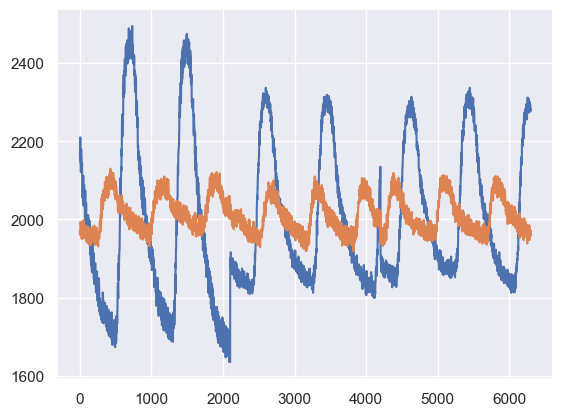

In [9]:
import matplotlib.pyplot as plt
plt.plot(all_dataframes[111])
plt.plot(all_dataframes[9])
signal = all_dataframes[111]

In [10]:
a = np.loadtxt("C:/Users/Nicholas Sudiyanto G/Downloads/5459299/PPG-BP Database/Data File/0_subject/111_1.txt")

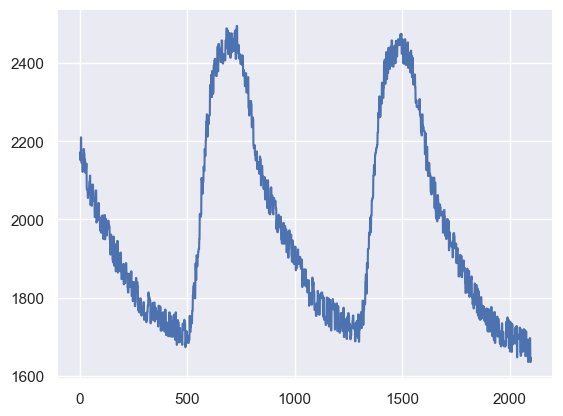

In [11]:
plt.plot(a)

## Now we implement the function for feature Extraction

In [12]:
# Filter requirements.
T = 20.0         # Sample Period
fs = 1000      # sample rate, Hz
cutoff = 15      # desired cutoff frequency of the filter, Hz ,      slightly higher than actual 1.2 Hz
lowcut = 0.1
highcut = 15
nyq = 0.5 * fs  # Nyquist Frequency
order = 2       # sin wave can be approx represented as quadratic
n = int(T * fs) # total number of samples

In [13]:
def butter_bandpass(lowcut, highcut, fs, order):
        nyq = 0.5 * fs
        low = lowcut / nyq
        high = highcut / nyq
        b, a = butter(order, [low, high], btype="bandpass", analog=False)
        return b, a

def butter_bandpass_filter(data, lowcut, highcut, fs, order):
        b, a = butter_bandpass(lowcut, highcut, fs, order)
        y = filtfilt(b, a, data)
        return y

In [14]:
def Finding_Morphology(signal, prominence_factor = 0.5):
    PPG_Morphology = []
    #Finding the peak and valley of signal  # Adjustable based on data
    dynamic_prominence = np.std(signal) * prominence_factor
    peaks, _ = find_peaks(signal, prominence=dynamic_prominence, distance=90)
    valley, _ = find_peaks(-signal, prominence=dynamic_prominence, distance =90)
    #Finding dicrotic notch and diastolic peak
    first_order = np.gradient(signal)
    first_order = hp.filter_signal(first_order, cutoff=[0.8,10], sample_rate=1000, order=1, filtertype='bandpass')
    second_order = np.gradient(first_order)
    second_order = hp.filter_signal(second_order, cutoff=[0.8,10], sample_rate=1000, order=1, filtertype='bandpass')
    dynamic_prominence = np.std(second_order) * prominence_factor
    peaksall, _ = find_peaks(second_order, prominence = dynamic_prominence)
    peaksa, _ = find_peaks(second_order[peaksall], prominence = dynamic_prominence,  distance =2)
    peaksa = peaksall[peaksa]
    mean = np.mean(second_order[peaksa])
    peaksa = list(peaksa)
    for i in peaksa:
        if second_order[i] < 0.5*mean:
            peaksa.remove(i)
    peaksrest = list(peaksall)
    for i in peaksa:
       peaksrest.remove(i)
    e = []
    for i in range (0, len(peaksa)-1):
        a = []
        for j in peaksrest:
            if peaksa[i] < j and peaksa[i+1] > j:
                a.append(j)
        if len(a) >= 1:
            if  a[0] > min(peaks, key=lambda x:abs(x-a[0])):
                e.append(a[0])
            else:
                try:
                    e.append(a[1])
                except:
                    continue
    e = np.array(e)
    valleysall, _ = find_peaks(-second_order, prominence = dynamic_prominence)
    valleyb, _ = find_peaks(-second_order[valleysall], prominence = dynamic_prominence,  distance =1)
    valleyb = valleysall[valleyb]
    peaksdia = list(valleysall)
    mean = np.mean(second_order[valleyb])
    valleyb = list(valleyb)
    for i in valleyb:
        if second_order[i] > 0.5*mean:
            valleyb.remove(i)
    for i in valleyb:
       peaksdia.remove(i)
    diastolic_peak = []
    for i in range (0, len(peaksa)-1):
        a = []
        for j in peaksdia:
            if peaksa[i] < j and peaksa[i+1] > j:
                a.append(j)
        if len(a) >= 1:
            if  a[0] > min(peaks, key=lambda x:abs(x-a[0])):
                diastolic_peak.append(a[0])
            else:
                try:
                    diastolic_peak.append(a[1])
                except:
                    continue
    diastolic_peak = np.array(diastolic_peak)
    PPG_Morphology.append(valley)
    PPG_Morphology.append(peaks)
    PPG_Morphology.append(e)
    PPG_Morphology.append(diastolic_peak)
    return PPG_Morphology

In [15]:
def PPG_Classification(PPG):
    PPG_window = []
    PPG_Morphology = Finding_Morphology(PPG)
    for j in range (0, len(PPG_Morphology[0])-1):
        PPG_signal = []
        for i in range (0, len(PPG_Morphology)):
            for k in PPG_Morphology[i]:
                if PPG_Morphology[0][j] <= k & k <= PPG_Morphology[0][j+1]:
                    PPG_signal.append(k)
        PPG_signal = [PPG_signal[0]] + PPG_signal[2:] + [PPG_signal[1]]
        PPG_window.append(PPG_signal)
    return PPG_window

In [16]:
def signal_check(signal, time, signal_morphology):
    #First, we check whether the morphology have in total 5 fiducial points:
    #2 valleys(start and end of signal), 1 systolic peak, 1 dicrotic notch, and 1 diastolic peak
    diff = 0
    n = 0
    a = []
    # for i in signal_morphology:
    #     if len(i) == 5:
    #         diff += signal[i[2]]-signal[i[3]]
    #         n += 1
    # mean = diff/n       
    accepted_signal = []
    total_height = []
    for i in signal_morphology:
        for k in signal_morphology:
            if signal[k[0]] > signal[k[-1]]:
                height = signal[k[1]] - signal[k[-1]]
            else:
                height = signal[k[1]] - signal[k[0]]
            total_height.append(height)
        mean_height = np.mean(total_height)
        individual_signal = []
        if signal[i[0]] > signal[i[-1]]:
            height = signal[i[1]] - signal[i[-1]]
        else:
            height = signal[i[1]] - signal[i[0]]
        width = time[i[-1]] - time[i[0]]
        for j in i: 
            individual_signal.append(signal[j])
        if len (i) == 5:
            if np.max(individual_signal) == signal[i[1]]: #Meaning the systolic peak is the highest peak in the signal
                if np.min(individual_signal) == signal[i[0]] or np.min(individual_signal) == signal[i[-1]]: # Meaning the lowest is the pulse onset
                    if i[0] < i[1] < i[2] < i[3] < i[4]:
                        if 0.5*mean_height < height < 1.5*mean_height:
                            accepted_signal.append(i)
    return accepted_signal

In [17]:
def normalize(signal):
    #We do min-max normalization
    signal = (signal - np.min(signal)) / (np.max(signal) - np.min(signal))
    return signal

In [18]:
def anchoring (chosen_data, chosen_time, morphology, show = True):
    total_signal_point = {}
    global anchor_point
    plt.figure(figsize=(20,10))
    j=0
    global start
    start = True
    for i in range (0, len(morphology)):
        if len(morphology[i]) == 5:
            signal_point = {}
            if start:
                anchor_point = (chosen_time[morphology[i][1]], chosen_data[morphology[i][1]])
                start = False
            x_diff = chosen_time[morphology[i][1]] - anchor_point[0]
            y_diff = chosen_data[morphology[i][1]] - anchor_point[1]
            signal_x = chosen_time[morphology[i][0]:morphology[i][-1]] - x_diff
            signal_y = chosen_data[morphology[i][0]:morphology[i][-1]] - y_diff
            pulse_onset_x = chosen_time[morphology[i][0]] - x_diff
            pulse_onset_y = chosen_data[morphology[i][0]] - y_diff
            signal_point['pulse_onset_x'] = pulse_onset_x
            signal_point['pulse_onset_y'] = pulse_onset_y
            systole_x = chosen_time[morphology[i][1]] - x_diff
            systole_y = chosen_data[morphology[i][1]] - y_diff
            signal_point['systole_x'] = systole_x
            signal_point['systole_y'] = systole_y
            dn_x = chosen_time[morphology[i][2]] - x_diff
            dn_y = chosen_data[morphology[i][2]] - y_diff
            signal_point['dn_x'] = dn_x
            signal_point['dn_y'] = dn_y
            dp_x = chosen_time[morphology[i][3]] - x_diff
            dp_y = chosen_data[morphology[i][3]] - y_diff
            signal_point['dp_x'] = dp_x
            signal_point['dp_y'] = dp_y
            pulse_end_x = chosen_time[morphology[i][4]] - x_diff
            pulse_end_y = chosen_data[morphology[i][4]] - y_diff
            signal_point['pulse_end_x'] = pulse_end_x
            signal_point['pulse_end_y'] = pulse_end_y
            if show == True:
                plt.plot(signal_x, signal_y)
                plt.plot(pulse_onset_x, pulse_onset_y, 'D', color = 'r')
                plt.plot(systole_x, systole_y, 'X', color = 'b')
                plt.plot(dn_x, dn_y, 's', color  = 'y')
                plt.plot(dp_x, dp_y, '*', color = 'g')
                plt.plot(pulse_end_x, pulse_end_y, 'D', color = 'orange')
            total_signal_point[j] = signal_point
            j += 1
    return total_signal_point

In [19]:
def anchoring1 (chosen_data, chosen_time, morphology, show = False):
    total_signal_point = {}
    global anchor_point
    plt.figure(figsize=(20,10))
    j=0
    global start
    start = True
    for i in range (0, len(morphology)):
        if len(morphology[i]) == 5:
            signal_point = {}
            if start:
                anchor_point = (chosen_time[morphology[i][0]], chosen_data[morphology[i][0]])
                start = False
            x_diff = chosen_time[morphology[i][0]] - anchor_point[0]
            y_diff = chosen_data[morphology[i][0]] - anchor_point[1]
            signal_x = chosen_time[morphology[i][0]:morphology[i][-1]] - x_diff
            signal_y = chosen_data[morphology[i][0]:morphology[i][-1]] - y_diff
            pulse_onset_x = chosen_time[morphology[i][0]] - x_diff
            pulse_onset_y = chosen_data[morphology[i][0]] - y_diff
            signal_point['pulse_onset_x'] = pulse_onset_x
            signal_point['pulse_onset_y'] = pulse_onset_y
            systole_x = chosen_time[morphology[i][1]] - x_diff
            systole_y = chosen_data[morphology[i][1]] - y_diff
            signal_point['systole_x'] = systole_x
            signal_point['systole_y'] = systole_y
            dn_x = chosen_time[morphology[i][2]] - x_diff
            dn_y = chosen_data[morphology[i][2]] - y_diff
            signal_point['dn_x'] = dn_x
            signal_point['dn_y'] = dn_y
            dp_x = chosen_time[morphology[i][3]] - x_diff
            dp_y = chosen_data[morphology[i][3]] - y_diff
            signal_point['dp_x'] = dp_x
            signal_point['dp_y'] = dp_y
            pulse_end_x = chosen_time[morphology[i][4]] - x_diff
            pulse_end_y = chosen_data[morphology[i][4]] - y_diff
            signal_point['pulse_end_x'] = pulse_end_x
            signal_point['pulse_end_y'] = pulse_end_y
            if show == True:
                plt.plot(signal_x, signal_y)
                plt.plot(pulse_onset_x, pulse_onset_y, 'D', color = 'r')
                plt.plot(systole_x, systole_y, 'X', color = 'b')
                plt.plot(dn_x, dn_y, 's', color  = 'y')
                plt.plot(dp_x, dp_y, '*', color = 'g')
                plt.plot(pulse_end_x, pulse_end_y, 'D', color = 'orange')
            total_signal_point[j] = signal_point
            j += 1
    return total_signal_point

In [20]:
def feature_analysis (signal_point, signal_point2, signal_feature = {}):
    total_individual_signal_features = {}
    pulse_onset_coordinate_x = []
    pulse_onset_coordinate_y = []
    systolic_peak_coordinate_x = []
    systolic_peak_coordinate_y = []
    dicrotic_notch_coordinate_x = []
    dicrotic_notch_coordinate_y = []
    diastolic_peak_coordinate_x = []
    diastolic_peak_coordinate_y = []
    pulse_end_coordinate = []
    for i in range(0, len(signal_point)):
        individual_signal_features = {}
        pulse_onset_coordinate_x.append(signal_point[i]['pulse_onset_x'])
        pulse_onset_coordinate_y.append(signal_point[i]['pulse_onset_y'])
        dicrotic_notch_coordinate_x.append(signal_point[i]['dn_x'])
        dicrotic_notch_coordinate_y.append(signal_point[i]['dn_y'])
        diastolic_peak_coordinate_x.append(signal_point[i]['dp_x'])
        diastolic_peak_coordinate_y.append(signal_point[i]['dp_y'])
        pulse_end_coordinate.append([signal_point[i]['pulse_end_x'], signal_point[i]['pulse_end_y']])
        pulse_time = signal_point[i]['pulse_end_x'] - signal_point[i]['pulse_onset_x']
        time_delay = signal_point[i]['dp_x'] - signal_point[i]['systole_x']
        crest_time = signal_point[i]['systole_x'] - signal_point[i]['pulse_onset_x']
        time_to_dn = signal_point[i]['dn_x'] - signal_point[i]['pulse_onset_x']
        time_to_dp = signal_point[i]['dp_x'] - signal_point[i]['pulse_onset_x']
        time_from_dn_to_end = pulse_time - (signal_point[i]['dn_x'] - signal_point[i]['pulse_onset_x'])
        time_ratio = crest_time/time_to_dn
        pulse_wave_amplitude = signal_point[i]['systole_y'] - signal_point[i]['pulse_onset_y']
        reflection_index = (signal_point[i]['dp_y'] - signal_point[i]['pulse_onset_y'])/pulse_wave_amplitude
        dicrotic_notch_amplitude = signal_point[i]['dn_y'] - signal_point[i]['pulse_onset_y']
        diastolic_peak_amplitude = signal_point[i]['dp_y'] - signal_point[i]['pulse_onset_y']
        individual_signal_features['pulse_time'] = pulse_time
        individual_signal_features['time_delay'] = time_delay
        individual_signal_features['crest_time'] = crest_time
        individual_signal_features['time_to_dn'] = time_to_dn
        individual_signal_features['time_to_dp'] = time_to_dp
        individual_signal_features['time_from_dn_to_end'] = time_from_dn_to_end
        individual_signal_features['time_ratio'] = time_ratio
        individual_signal_features['pulse_wave_amplitude'] = pulse_wave_amplitude
        individual_signal_features['reflection_index'] = reflection_index
        individual_signal_features['dicrotic_notch_amplitude'] = dicrotic_notch_amplitude
        individual_signal_features['diastolic_peak_amplitude'] = diastolic_peak_amplitude
        total_individual_signal_features[i] = individual_signal_features
    for i in range(0, len(signal_point2)):
        systolic_peak_coordinate_x.append(signal_point2[i]['systole_x'])
        systolic_peak_coordinate_y.append(signal_point2[i]['systole_y'])
    for j in total_individual_signal_features.values():
        for k in j.keys():
            a=[]
            for i in total_individual_signal_features:
                a.append(total_individual_signal_features[i].get(k))
            mean = np.mean(a)
            signal_feature[k] = mean
    signal_feature['pulse_onset_time_variance'] = np.var(pulse_onset_coordinate_x)
    signal_feature['pulse_onset_amplitude_variance'] = np.var(pulse_onset_coordinate_y)
    signal_feature['systolic_peak_time_variance'] = np.var(systolic_peak_coordinate_x)
    signal_feature['systolic_peak_amplitude_variance'] = np.var(systolic_peak_coordinate_y)
    signal_feature['dicrotic_notch_time_variance'] = np.var(dicrotic_notch_coordinate_x)
    signal_feature['dicrotic_notch_amplitude_variance'] = np.var(dicrotic_notch_coordinate_y)
    signal_feature['diastolic_peak_time_variance'] = np.var(diastolic_peak_coordinate_x)
    signal_feature['diastolic_peak_amplitude_variance'] = np.var(diastolic_peak_coordinate_y)
    return signal_feature

In [21]:
data = all_dataframes[111]
a= [] 
for k in range(len(data)):
    k = (k*1000) / 1000
    a.append(k)
data = data.to_frame().assign(time=a)
data = data.rename(columns={data.columns[0]: 'PPG', data.columns[1]: 'time'})
data['PPG'] = hp.filter_signal(data['PPG'], cutoff=[0.8,10], sample_rate=1000, order=1, filtertype='bandpass')

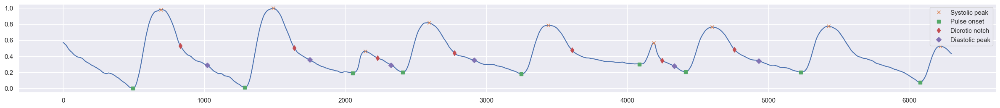

In [22]:
combined_signal = data['PPG']
combined_time = data['time']
combined_signal = normalize(combined_signal)
chosen_data = np.array(combined_signal)
chosen_time = np.array(combined_time)
PPG_Morphology = Finding_Morphology(chosen_data, prominence_factor = 0.3)
morphology = PPG_Classification(chosen_data)
morphology = signal_check(chosen_data, combined_time, morphology)
fig = plt.figure(figsize=(30,6))
ax = fig.add_subplot(211)
plt.plot(chosen_time, chosen_data)
plt.plot(chosen_time[PPG_Morphology[1]], chosen_data[PPG_Morphology[1]], "x", label = "Systolic peak")
plt.plot(chosen_time[PPG_Morphology[0]], chosen_data[PPG_Morphology[0]], "s", label = "Pulse onset")
plt.plot(chosen_time[PPG_Morphology[2]], chosen_data[PPG_Morphology[2]], "d", label = "Dicrotic notch")
plt.plot(chosen_time[PPG_Morphology[3]], chosen_data[PPG_Morphology[3]], "D", label = "Diastolic peak")
plt.legend(loc='best')

In [23]:
a = anchoring(chosen_data, chosen_time, morphology, show = False)
b = anchoring1(chosen_data, chosen_time, morphology, show = False)
c = feature_analysis (a, b, signal_feature = {})
c

{'pulse_time': 584.5,
 'time_delay': 302.5,
 'crest_time': 145.0,
 'time_to_dn': 264.0,
 'time_to_dp': 447.5,
 'time_from_dn_to_end': 320.5,
 'time_ratio': 0.5733657154422183,
 'pulse_wave_amplitude': 0.4430615935512494,
 'reflection_index': 0.0367299907178154,
 'dicrotic_notch_amplitude': 0.1432971322931258,
 'diastolic_peak_amplitude': 0.03653206778796765,
 'pulse_onset_time_variance': 1764.0,
 'pulse_onset_amplitude_variance': 0.0304836512550287,
 'systolic_peak_time_variance': 1764.0,
 'systolic_peak_amplitude_variance': 0.030483651255028697,
 'dicrotic_notch_time_variance': 3600.0,
 'dicrotic_notch_amplitude_variance': 0.006011175534298295,
 'diastolic_peak_time_variance': 25122.25,
 'diastolic_peak_amplitude_variance': 0.013636198520519394}

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

C:\Users\Nicholas Sudiyanto G\AppData\Local\Programs\Python\Python312\Lib\site-packages\numpy\core\fromnumeric.py:3787: RuntimeWarning: Degrees of freedom <= 0 for slice
  return _methods._var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Nicholas Sudiyanto G\AppData\Local\Temp\ipykernel_30420\3815002968.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(20,10))
C:\Users\Nicholas Sudiyanto G\AppData\Local\Programs\Python\Python312\Lib\site-packages\numpy\core\fromnumeric.py:3787: RuntimeWarning: Degrees of freedom <= 0 for slice
  return _methods._var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Nicholas Sudiyanto G\AppData\Local\Programs\Python\Python312\Lib\site-packages\numpy\c

An error occurred: arrays used as indices must be of integer (or boolean) type


C:\Users\Nicholas Sudiyanto G\AppData\Local\Programs\Python\Python312\Lib\site-packages\numpy\core\fromnumeric.py:3787: RuntimeWarning: Degrees of freedom <= 0 for slice
  return _methods._var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Nicholas Sudiyanto G\AppData\Local\Programs\Python\Python312\Lib\site-packages\numpy\core\fromnumeric.py:3787: RuntimeWarning: Degrees of freedom <= 0 for slice
  return _methods._var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Nicholas Sudiyanto G\AppData\Local\Programs\Python\Python312\Lib\site-packages\numpy\core\fromnumeric.py:3787: RuntimeWarning: Degrees of freedom <= 0 for slice
  return _methods._var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Nicholas Sudiyanto G\AppData\Local\Programs\Python\Python312\Lib\site-packages\numpy\core\fromnumeric.py:3787: RuntimeWarning: Degrees of freedom <= 0 for slice
  return _methods._var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Nicholas Sudiyanto G\AppData\Lo

An error occurred: arrays used as indices must be of integer (or boolean) type


C:\Users\Nicholas Sudiyanto G\AppData\Local\Programs\Python\Python312\Lib\site-packages\numpy\core\fromnumeric.py:3787: RuntimeWarning: Degrees of freedom <= 0 for slice
  return _methods._var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Nicholas Sudiyanto G\AppData\Local\Programs\Python\Python312\Lib\site-packages\numpy\core\fromnumeric.py:3787: RuntimeWarning: Degrees of freedom <= 0 for slice
  return _methods._var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Nicholas Sudiyanto G\AppData\Local\Programs\Python\Python312\Lib\site-packages\numpy\core\fromnumeric.py:3787: RuntimeWarning: Degrees of freedom <= 0 for slice
  return _methods._var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Nicholas Sudiyanto G\AppData\Local\Programs\Python\Python312\Lib\site-packages\numpy\core\fromnumeric.py:3787: RuntimeWarning: Degrees of freedom <= 0 for slice
  return _methods._var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
C:\Users\Nicholas Sudiyanto G\AppData\Lo

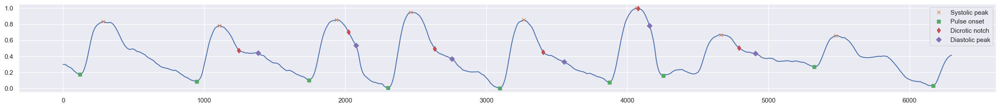

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

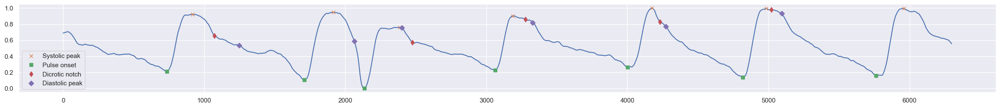

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

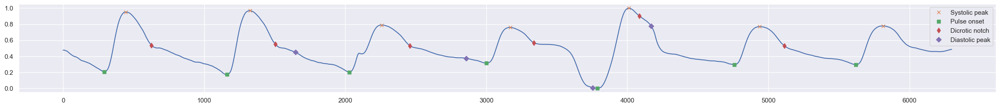

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

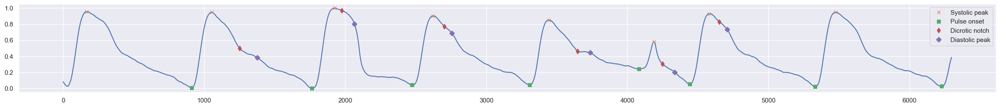

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

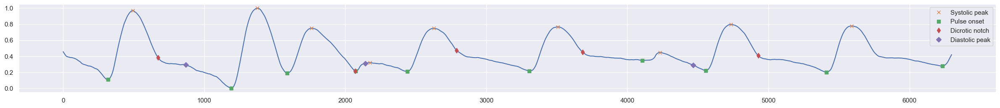

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

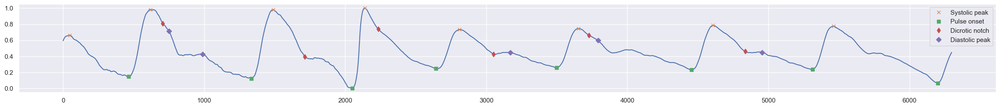

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

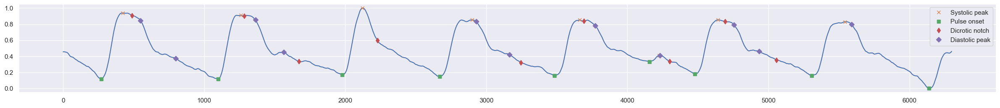

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

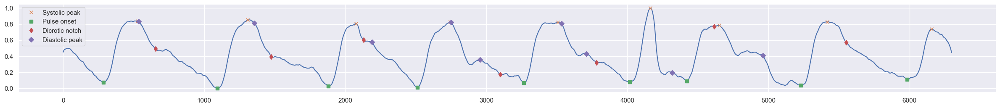

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

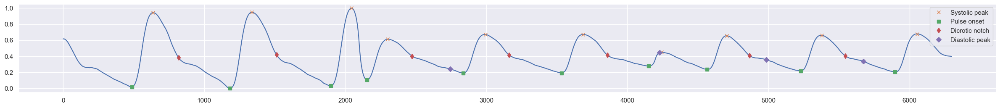

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

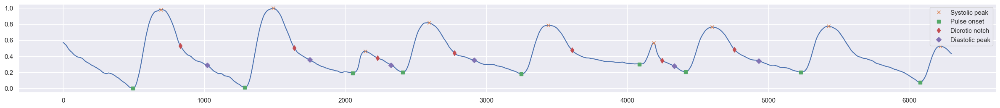

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

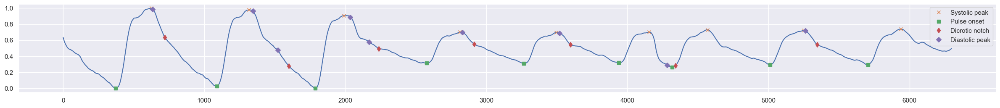

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

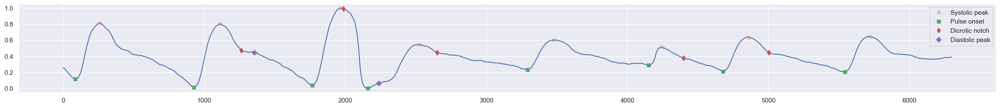

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

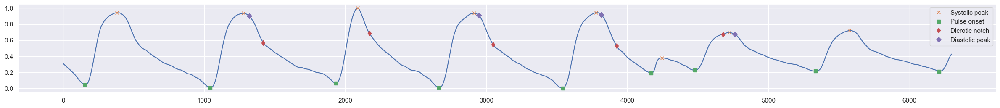

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

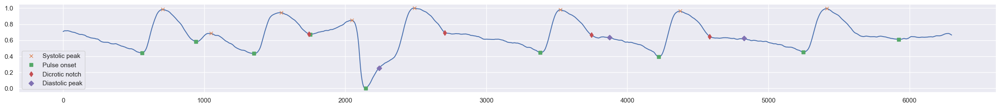

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

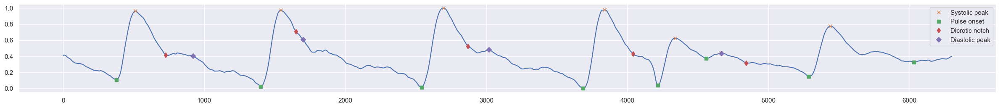

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

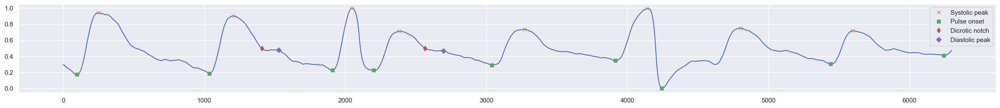

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

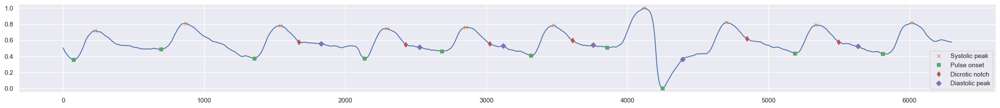

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

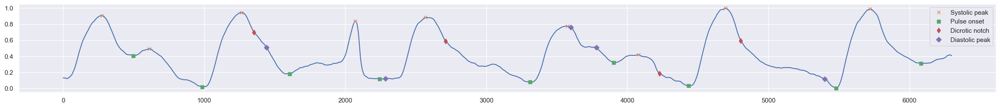

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

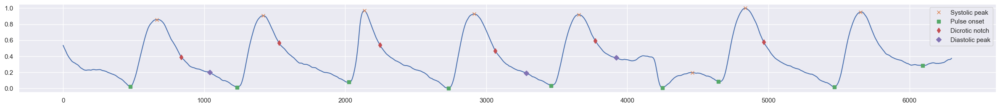

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

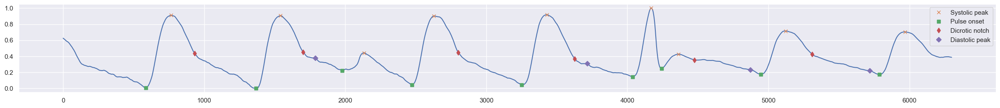

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

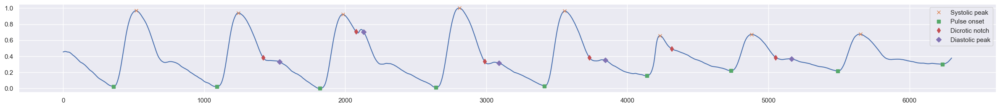

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

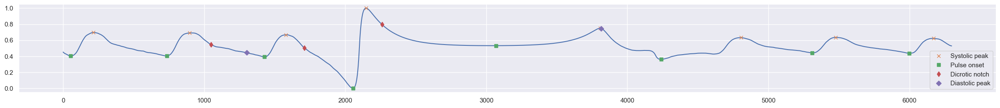

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

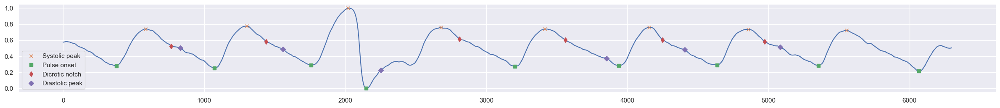

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

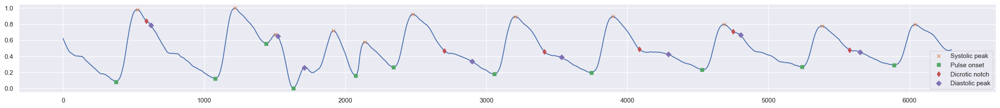

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

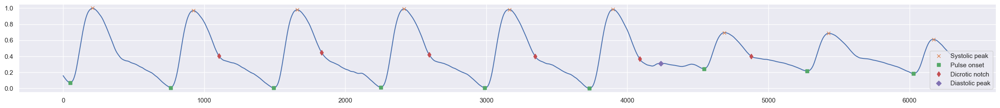

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

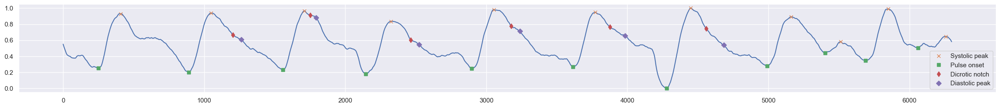

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

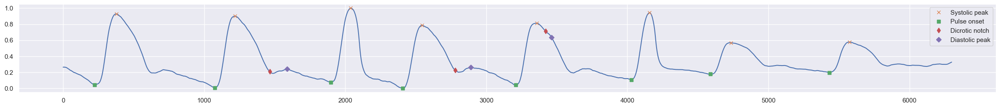

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

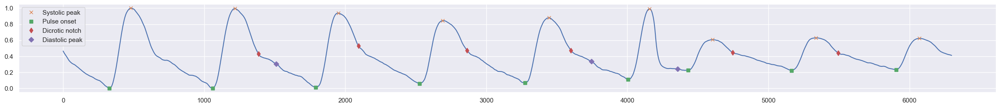

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

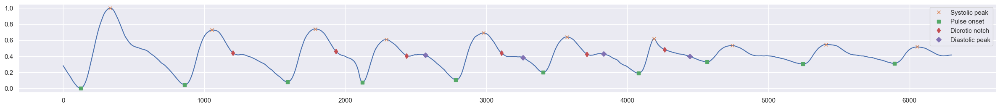

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

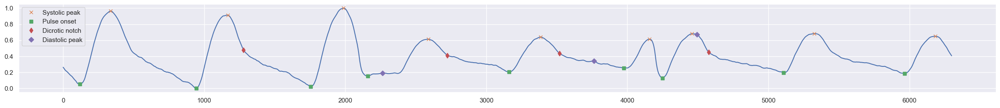

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

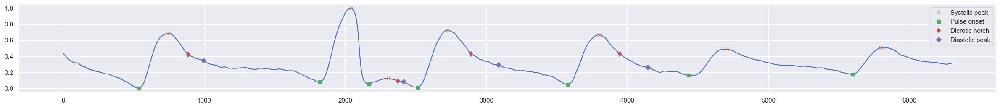

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

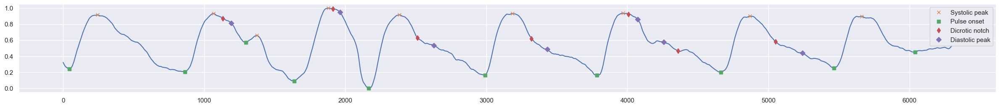

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

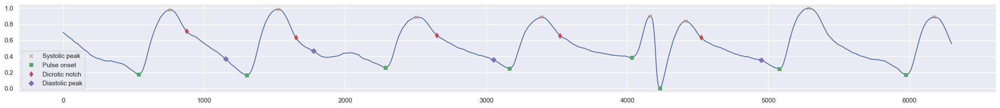

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

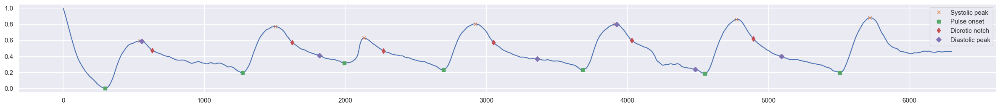

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

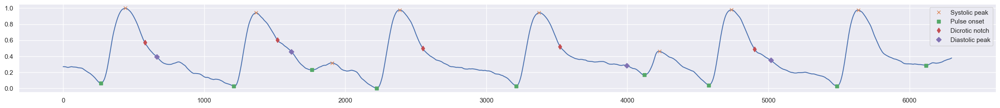

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

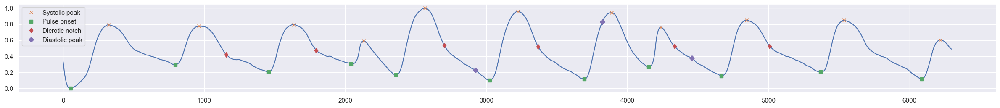

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

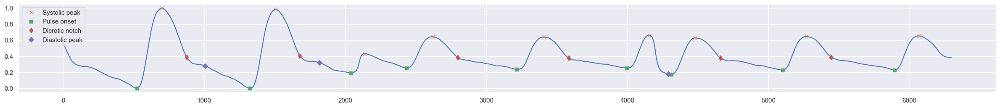

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

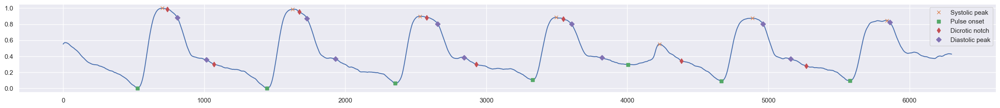

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

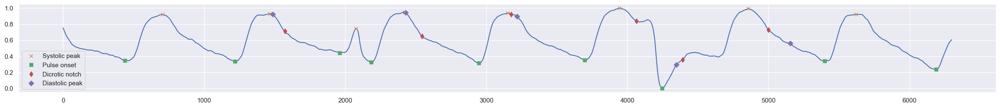

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

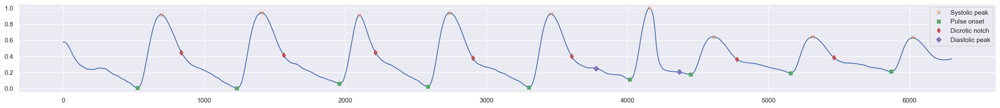

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

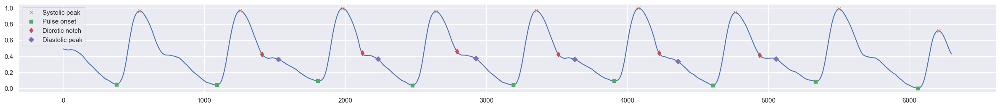

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

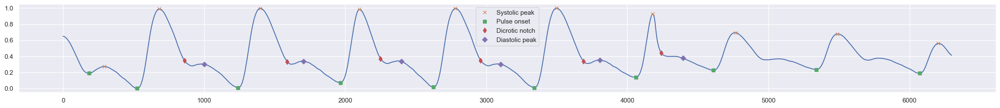

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

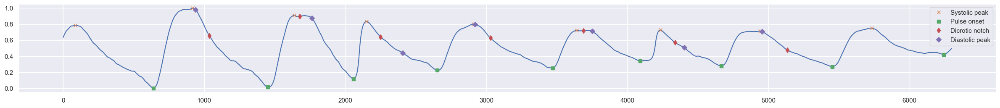

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

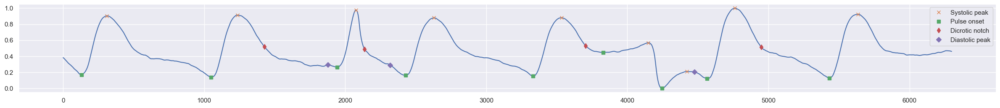

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

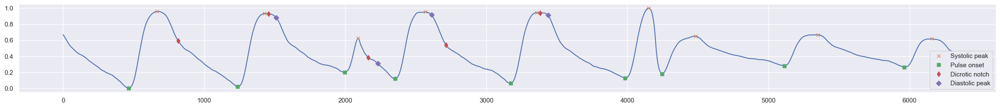

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

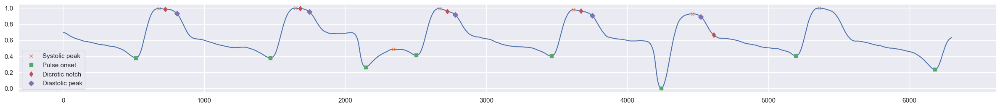

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

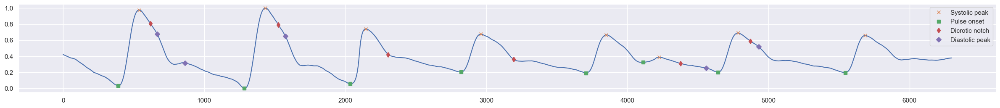

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

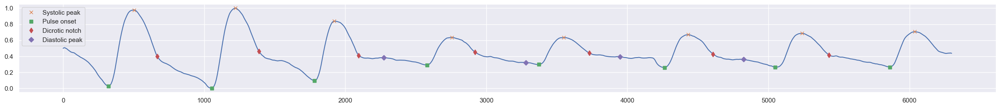

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

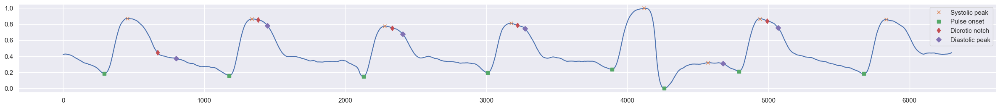

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

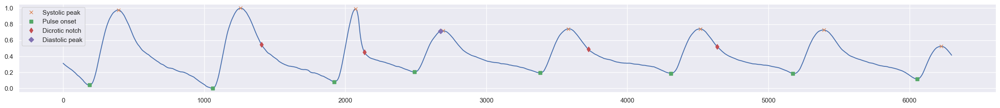

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

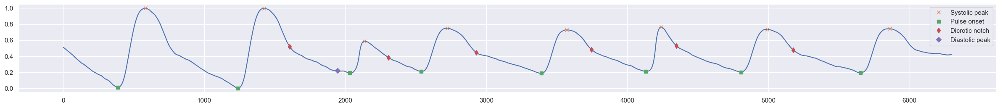

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

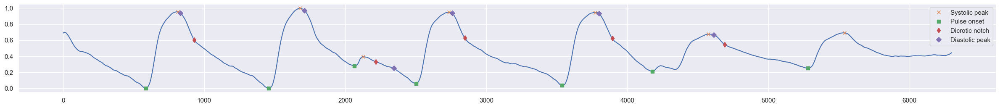

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

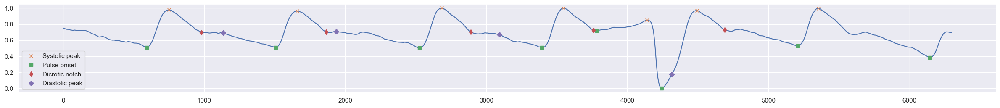

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

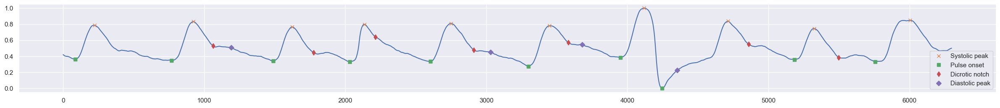

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

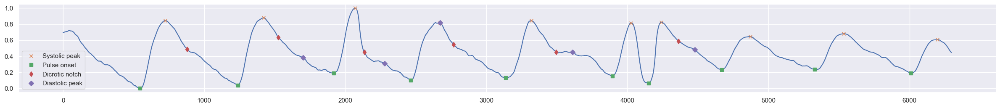

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

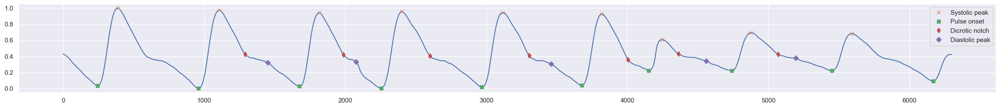

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

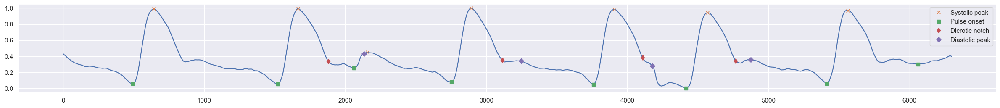

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

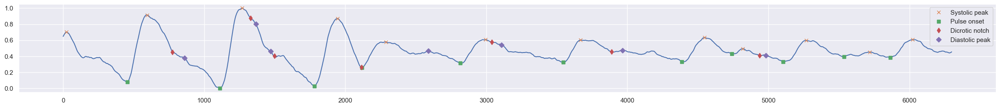

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

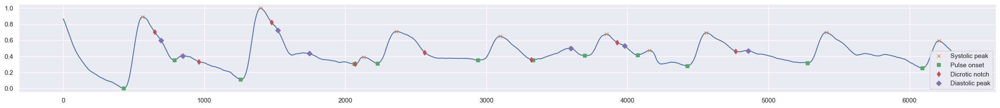

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

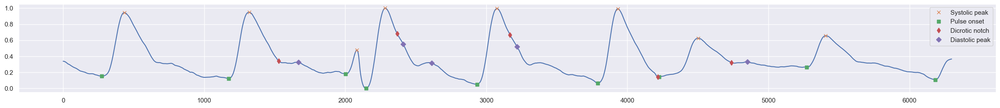

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

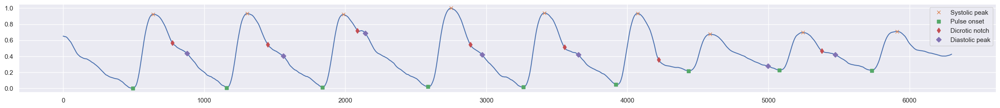

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

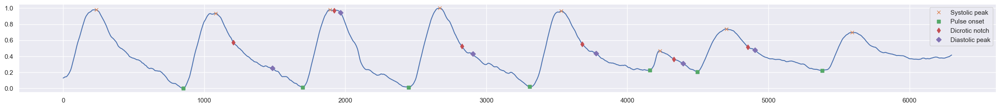

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

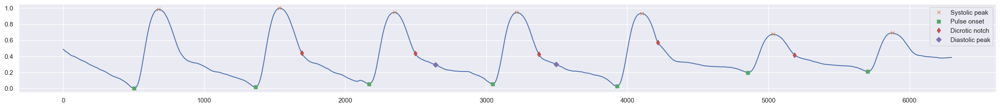

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

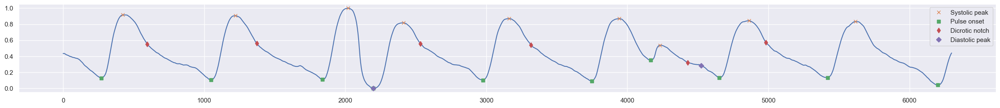

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

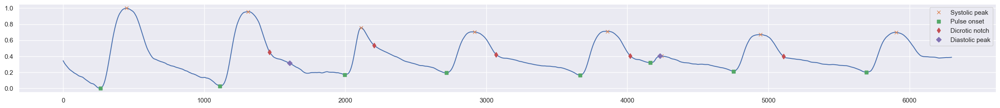

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

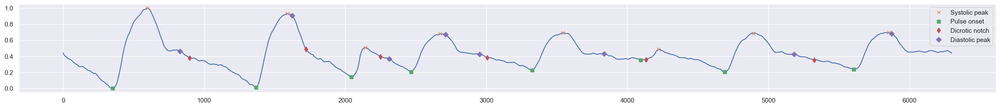

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

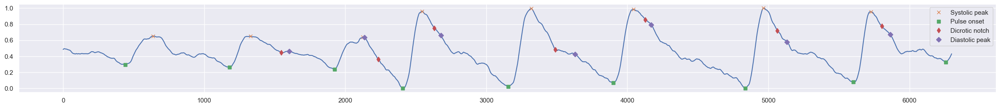

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

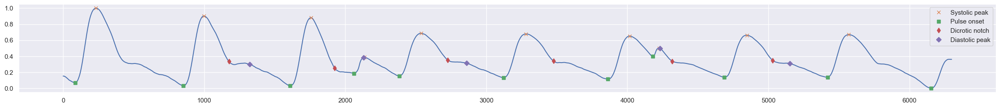

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

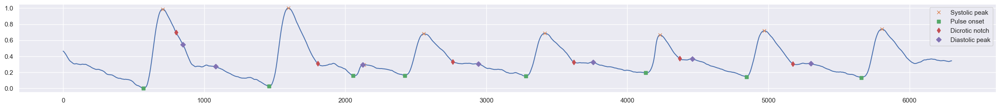

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

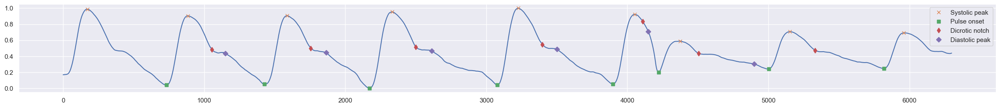

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

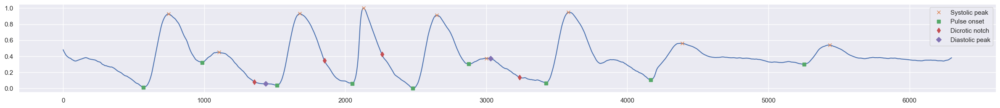

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

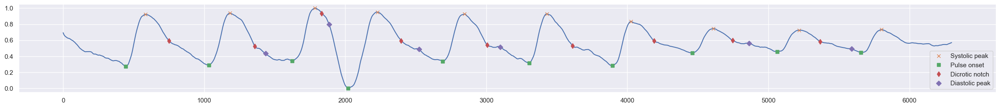

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

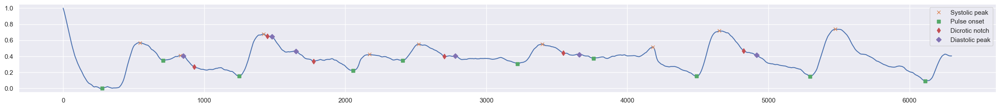

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

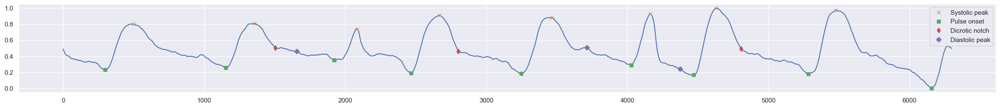

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

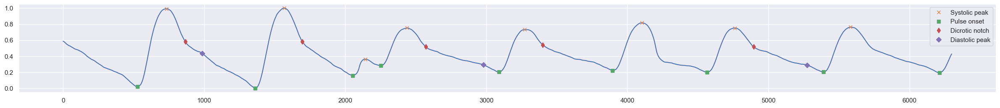

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

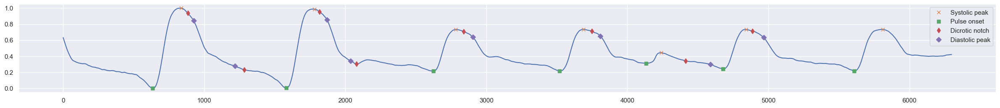

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

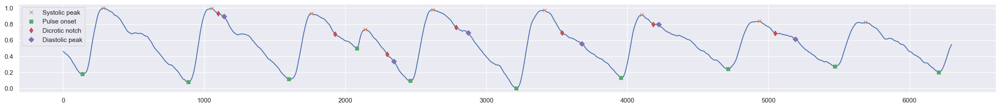

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

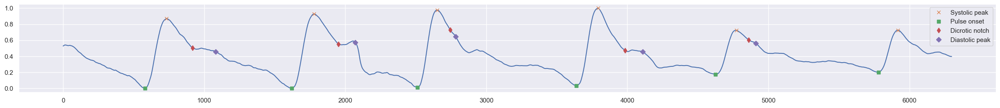

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

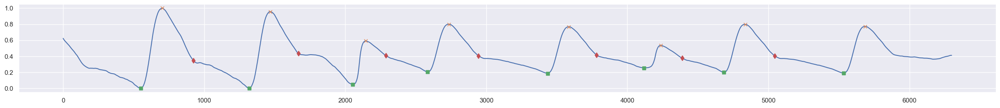

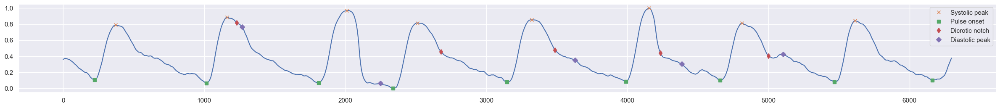

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

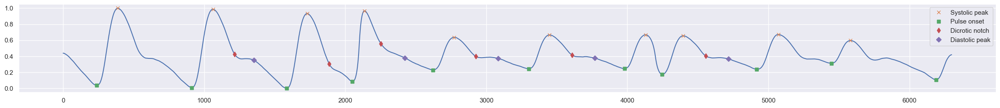

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

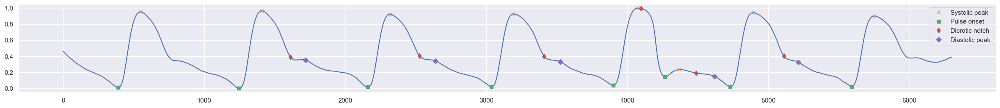

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

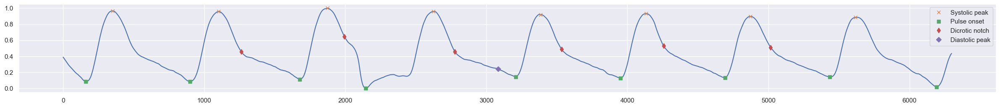

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

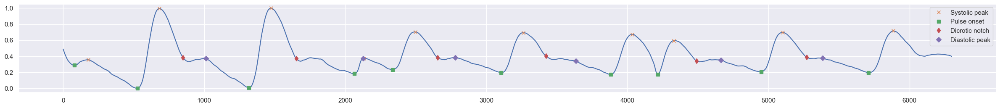

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

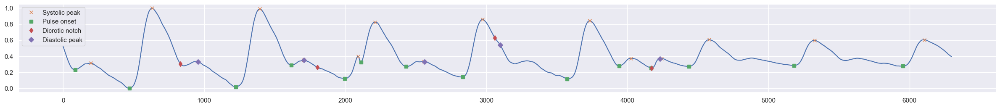

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

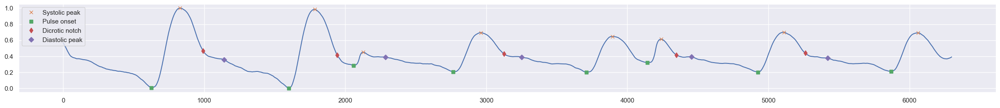

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

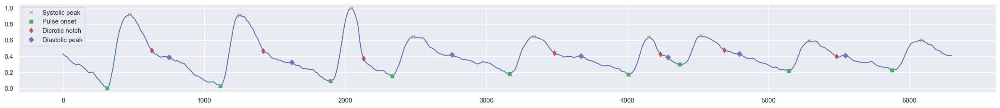

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

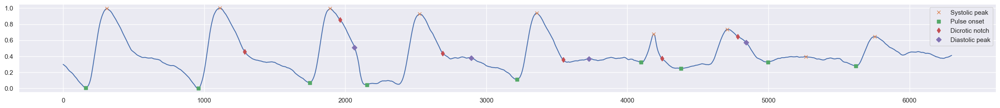

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

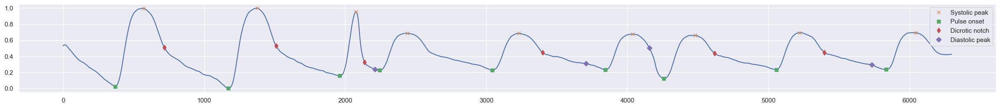

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

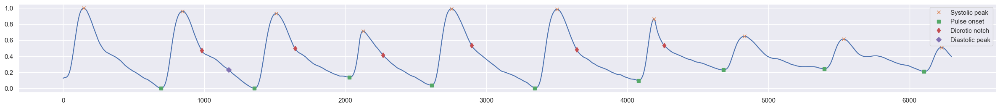

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

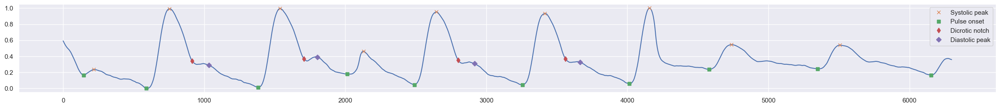

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

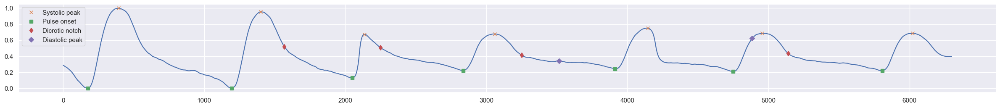

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

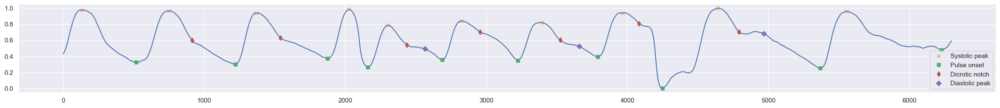

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

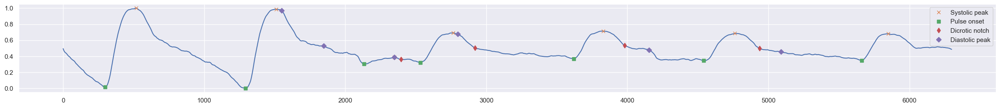

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

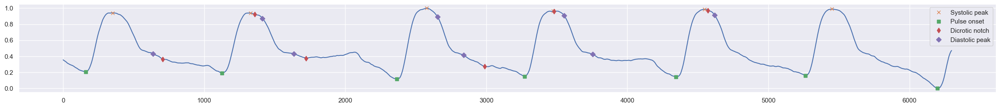

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

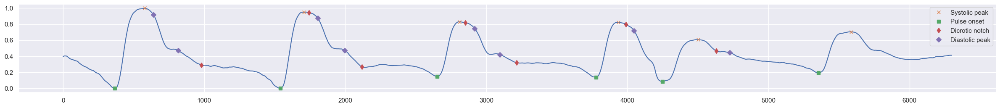

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

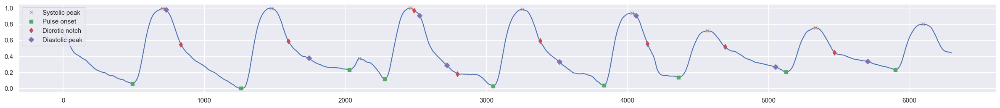

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

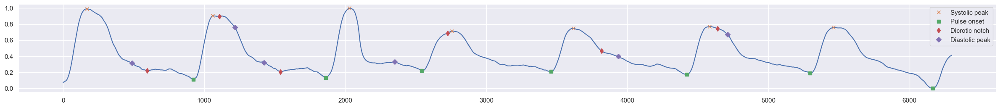

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

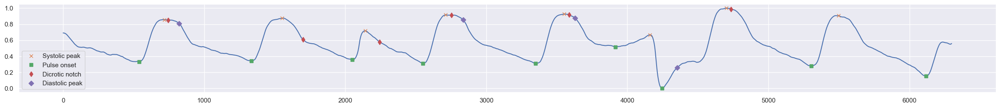

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

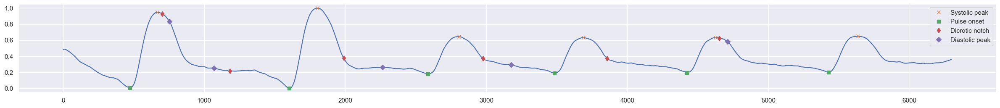

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

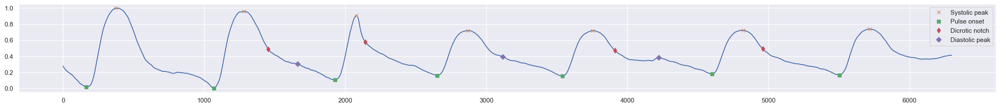

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

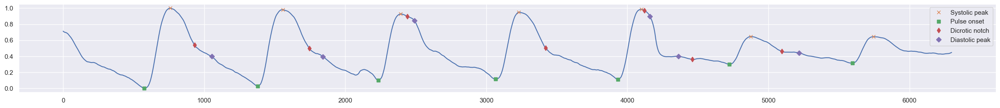

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

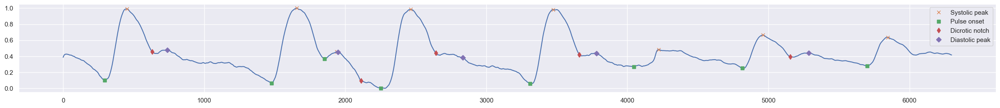

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

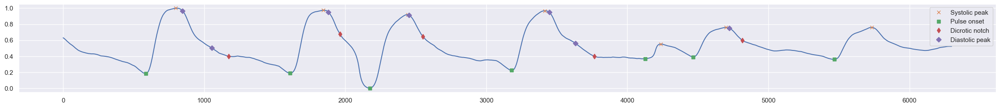

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

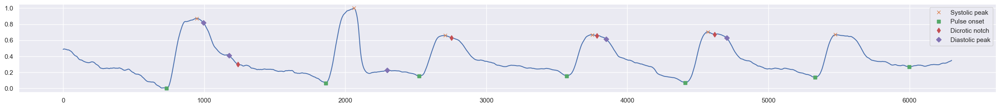

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

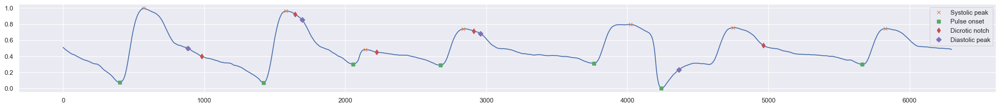

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

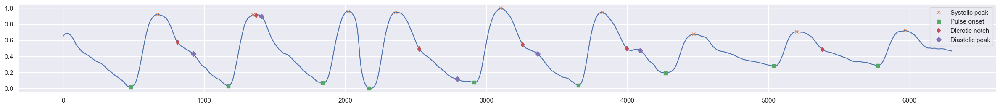

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

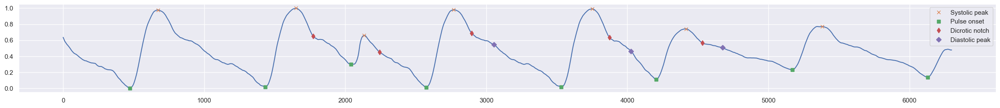

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

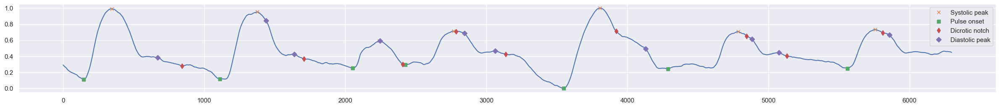

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

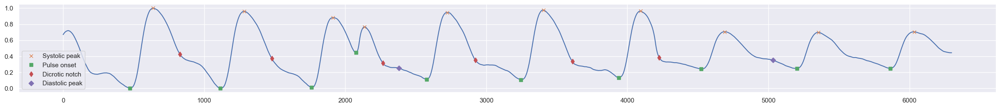

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

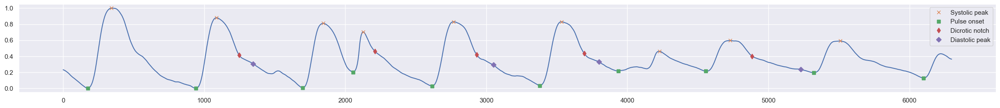

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

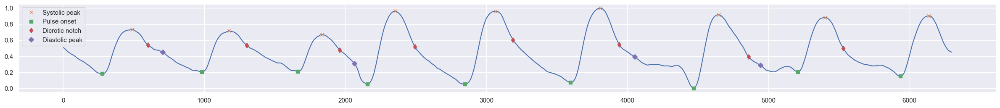

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

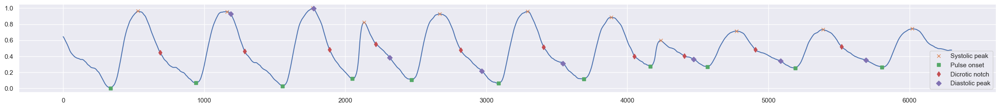

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

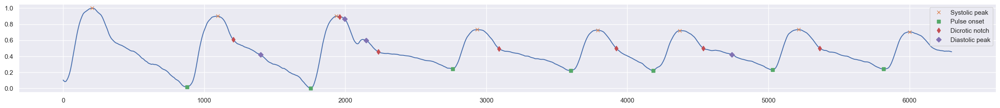

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

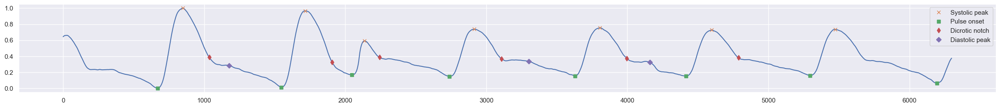

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

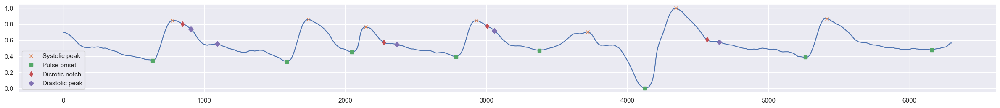

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

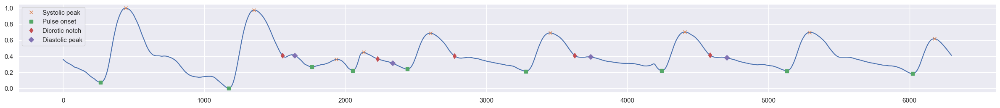

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

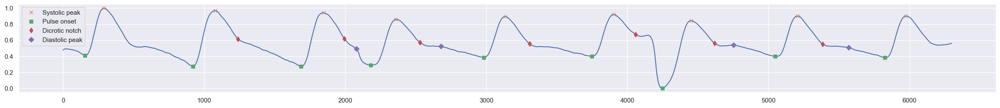

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

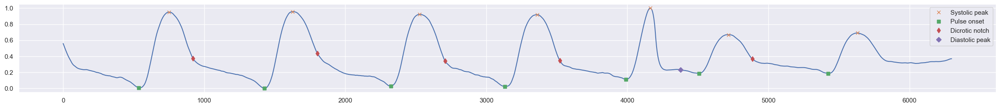

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

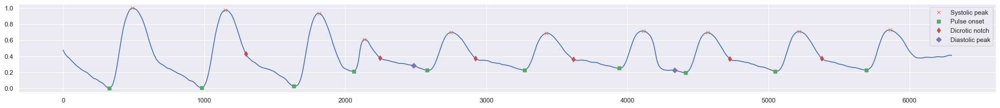

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

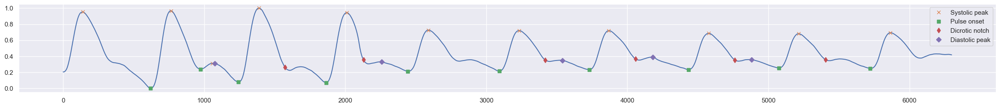

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

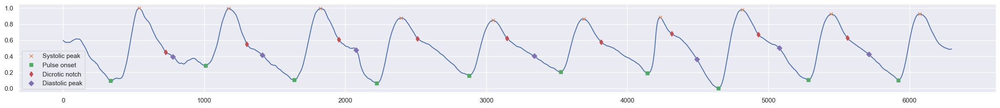

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

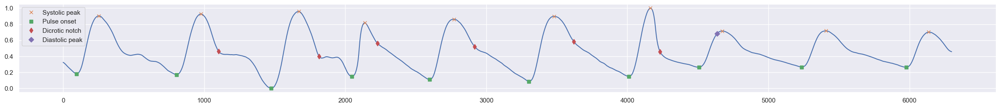

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

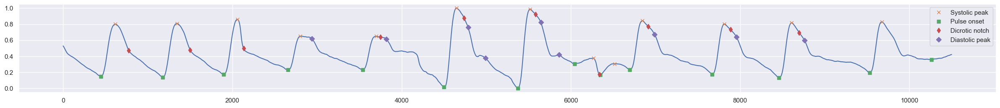

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

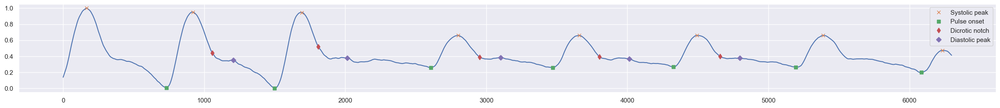

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

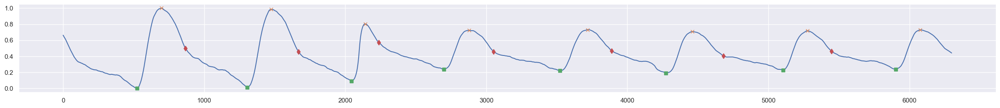

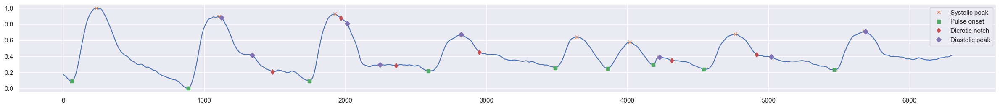

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

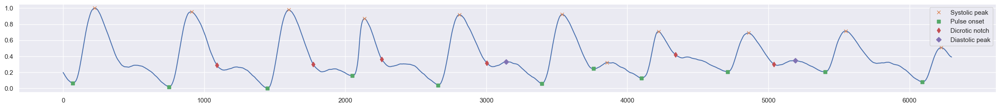

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

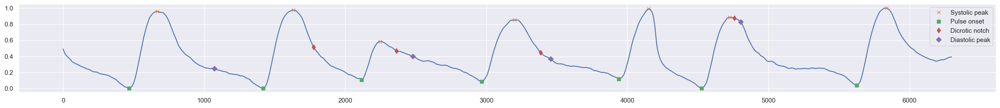

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

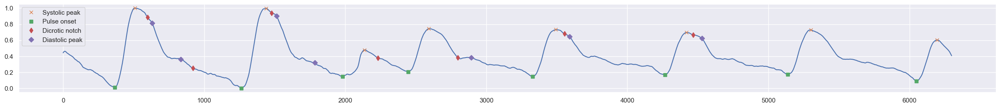

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

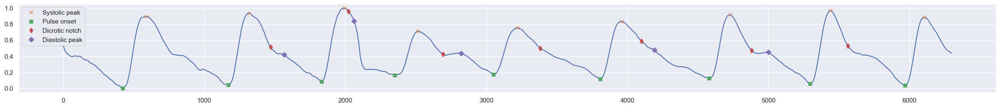

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

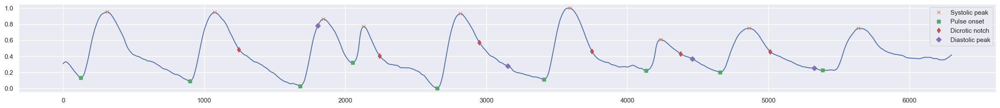

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

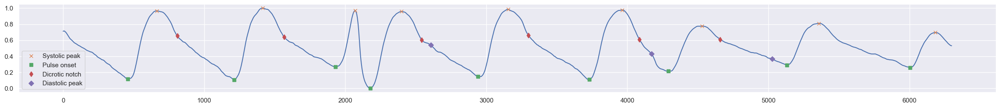

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

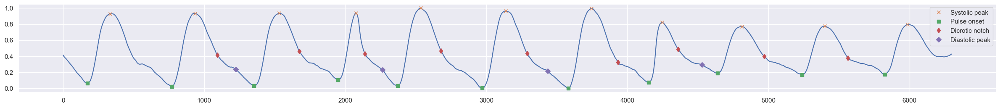

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

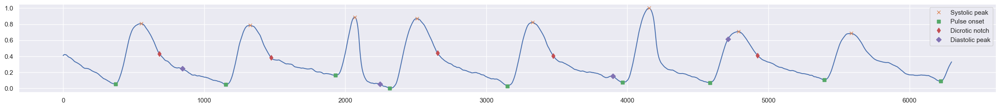

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

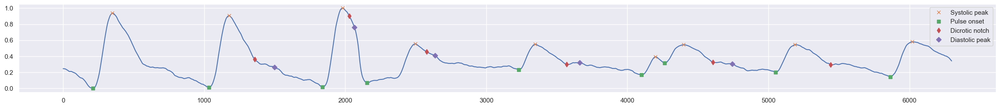

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

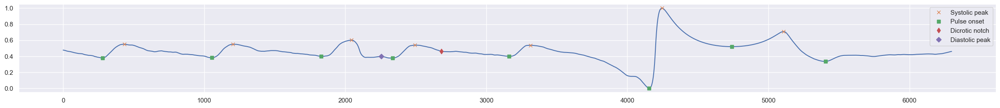

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

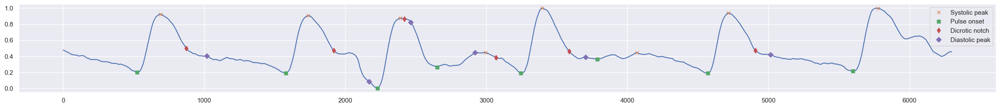

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

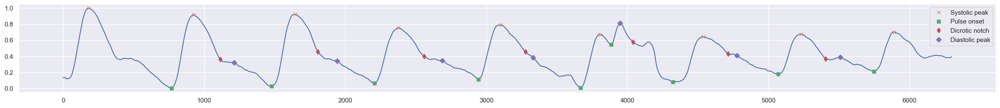

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

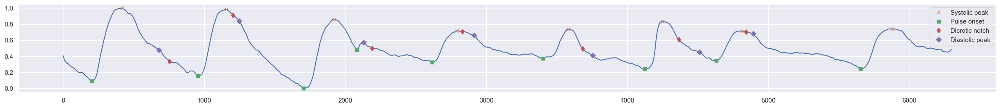

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

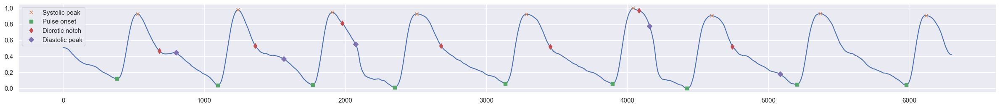

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

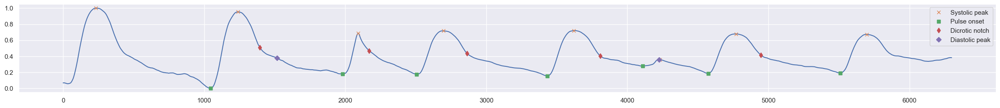

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

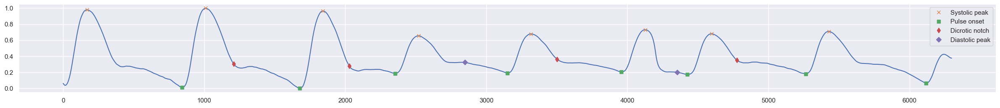

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

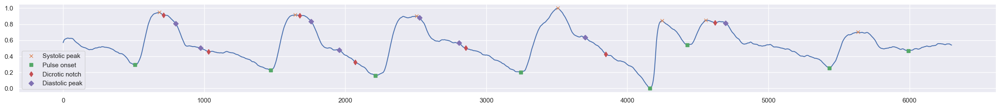

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

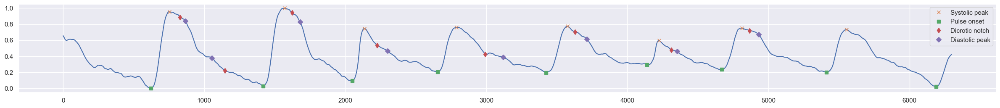

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

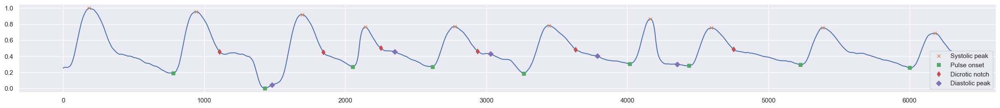

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

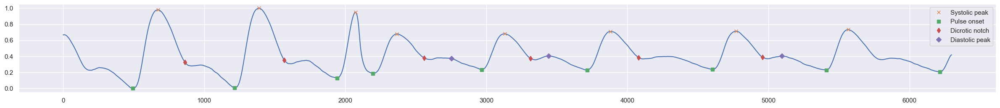

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

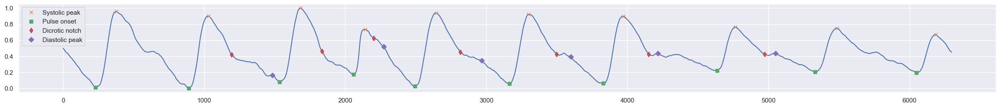

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

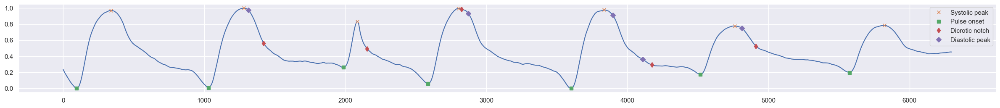

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

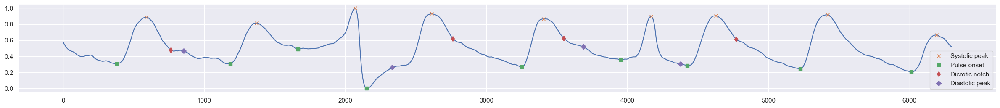

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

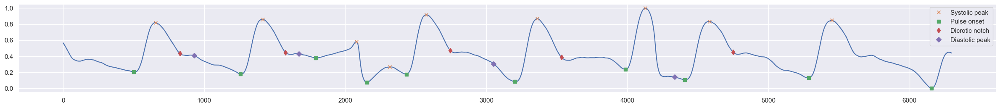

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

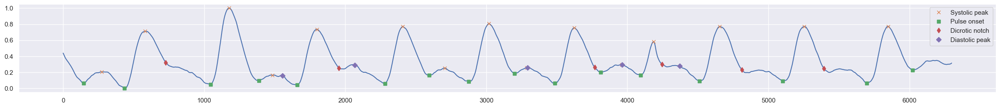

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

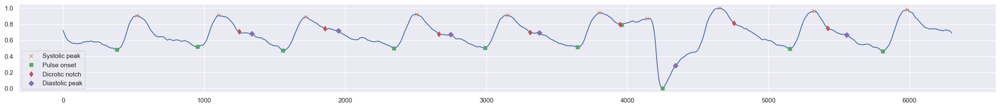

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

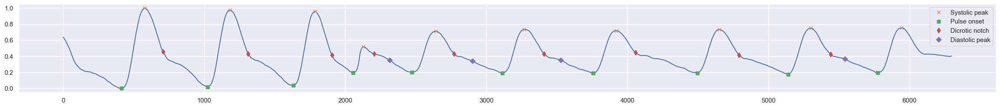

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

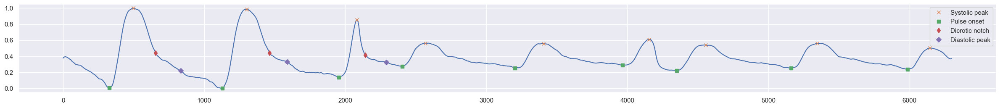

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

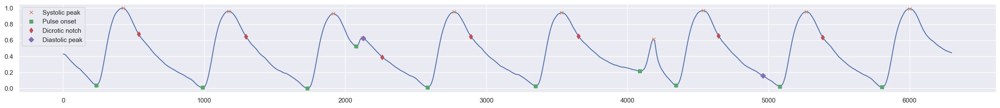

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

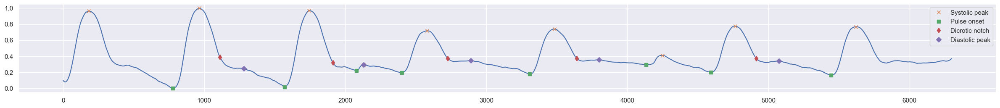

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

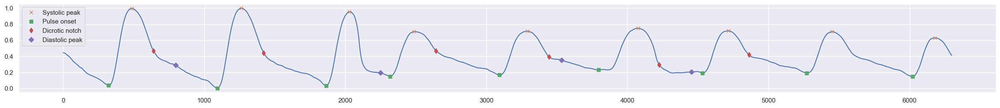

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

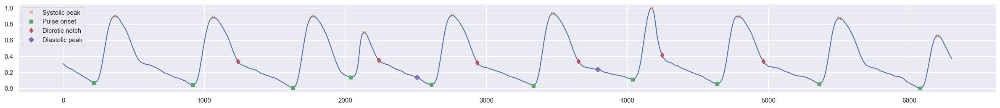

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

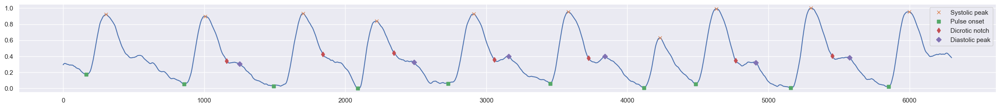

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

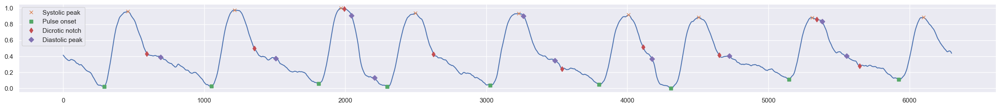

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

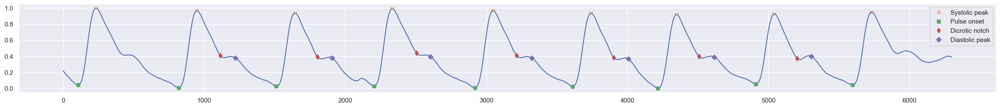

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

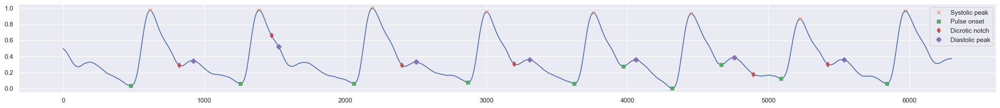

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

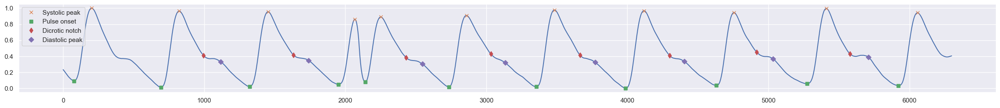

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

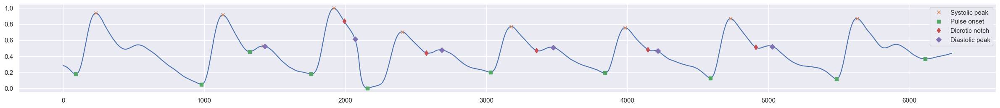

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

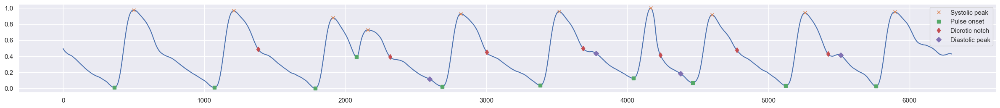

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

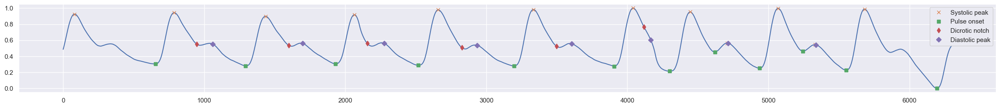

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

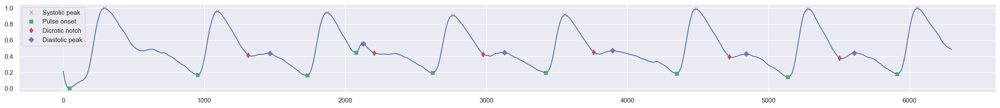

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

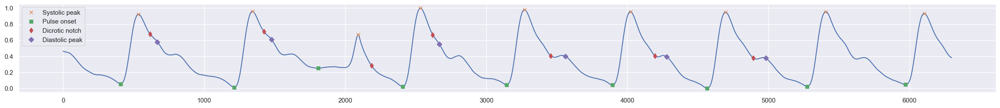

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

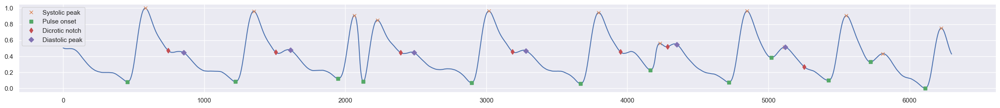

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

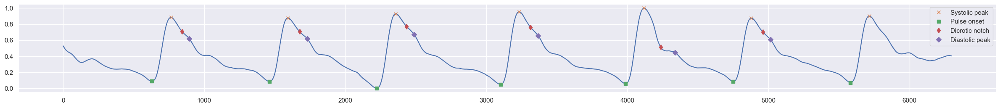

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

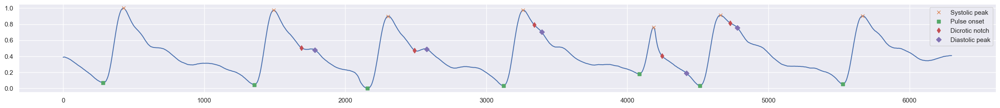

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

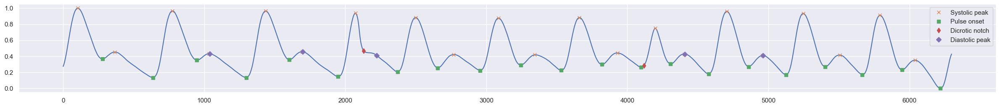

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

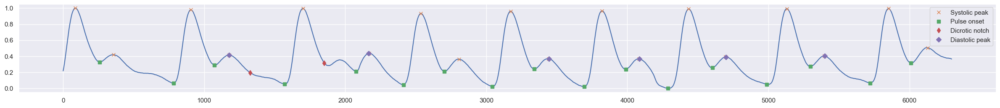

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

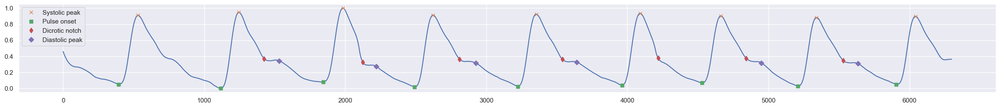

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

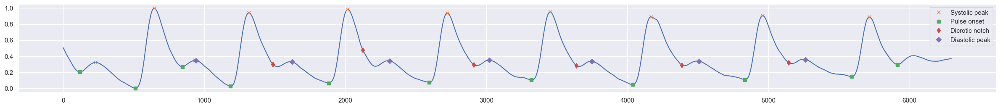

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

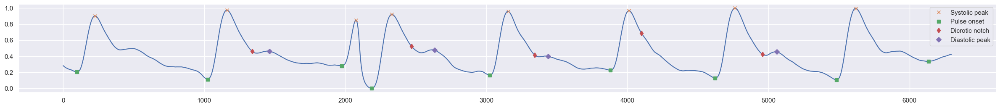

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

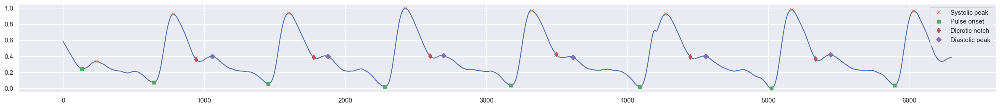

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

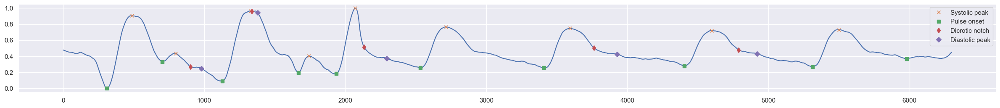

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

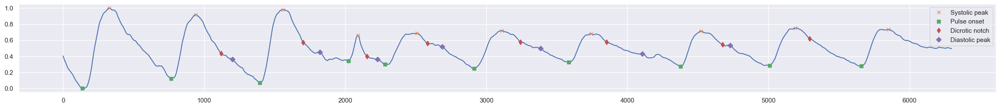

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

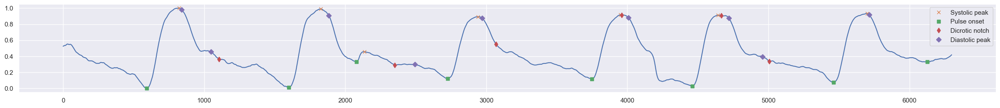

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

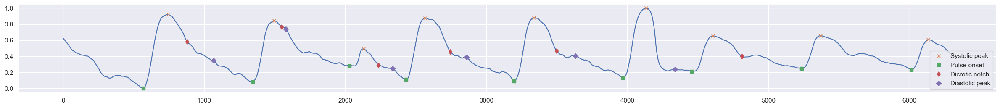

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

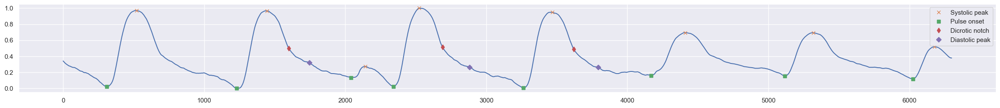

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

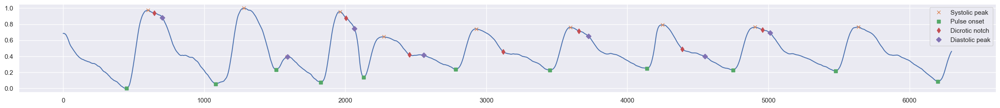

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

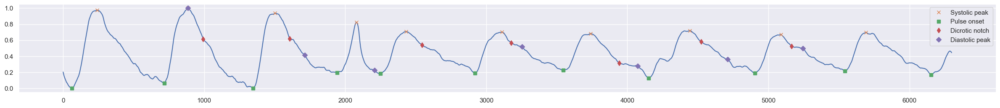

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

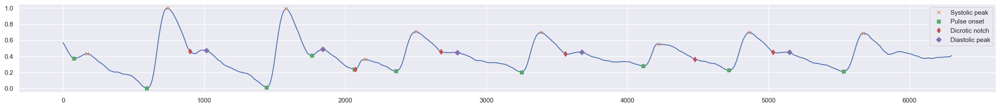

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

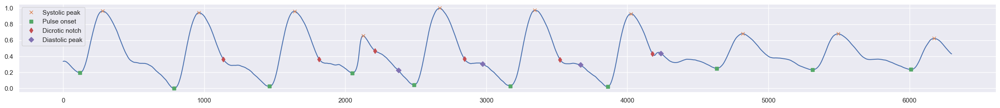

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

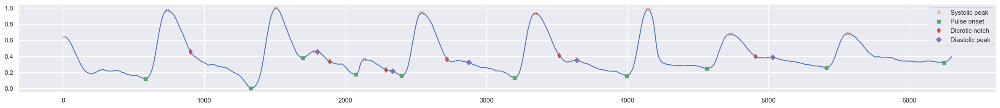

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

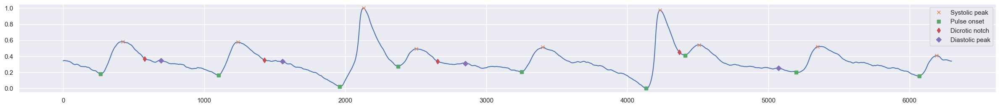

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

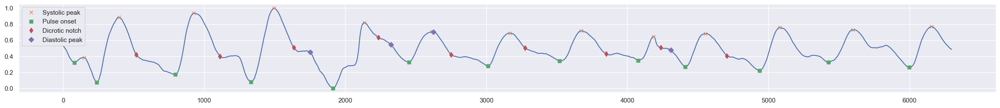

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

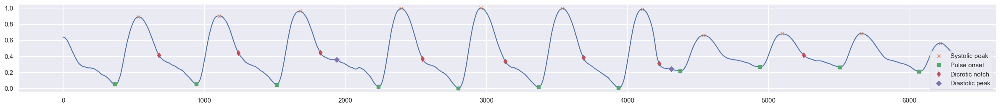

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

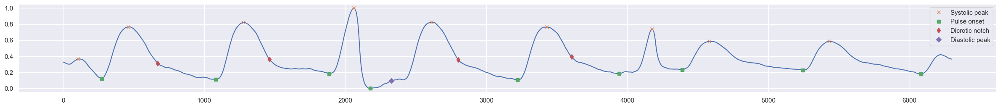

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

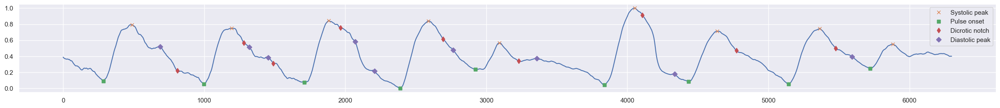

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

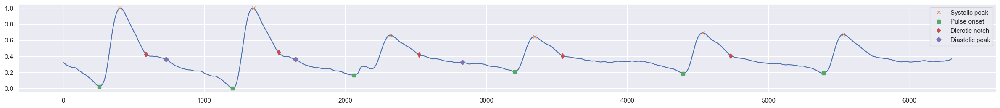

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

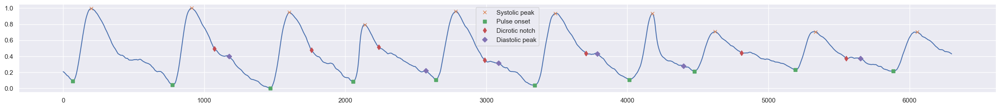

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

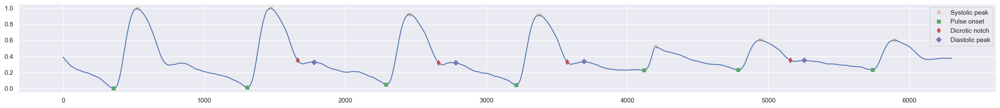

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

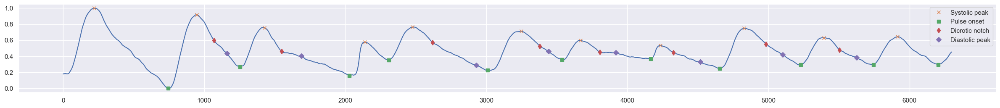

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

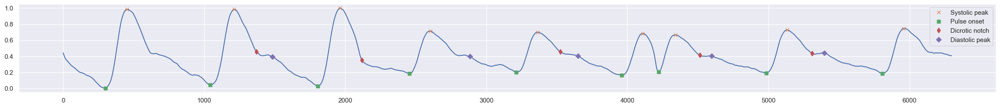

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

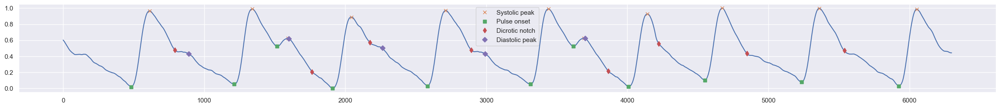

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

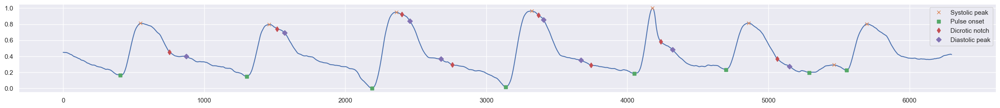

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

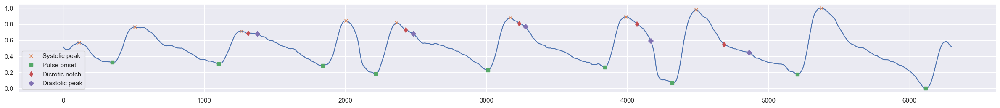

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

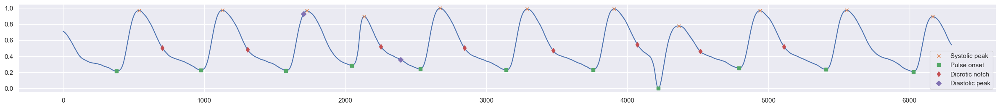

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

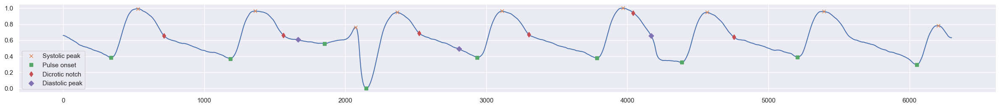

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

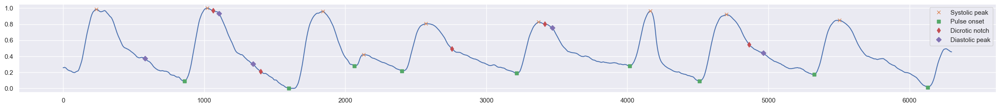

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

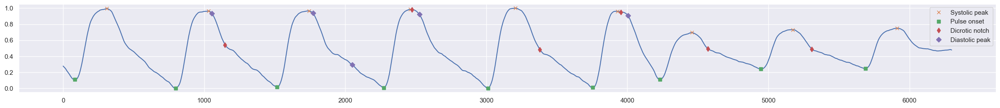

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

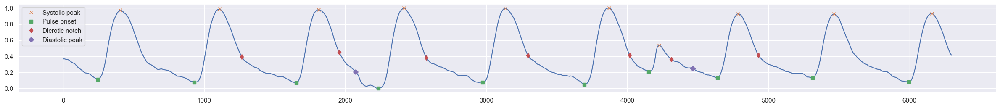

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

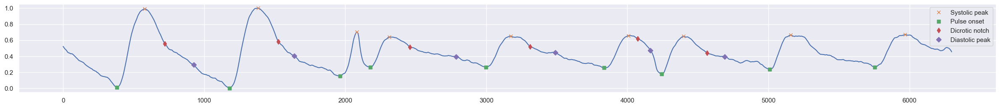

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

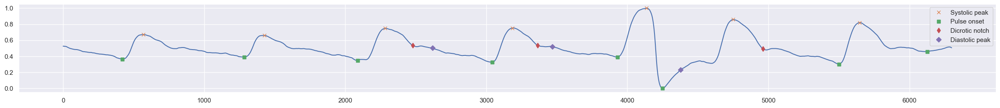

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

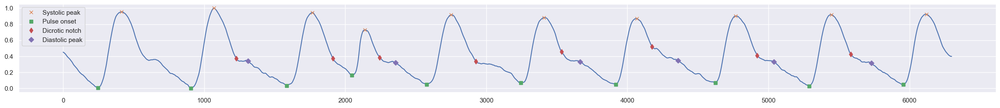

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

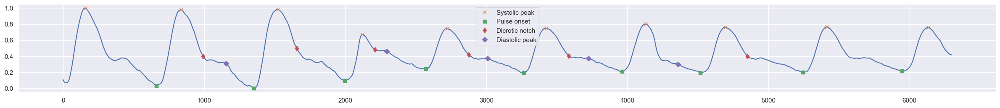

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

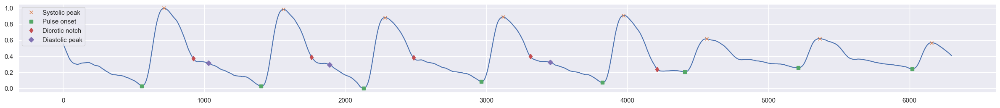

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

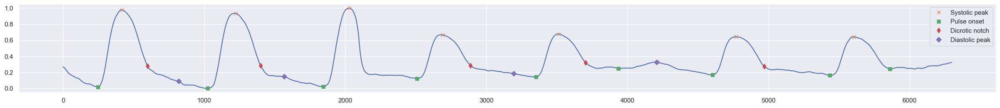

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

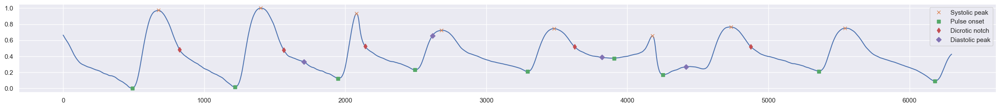

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

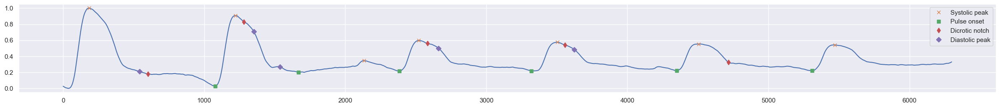

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

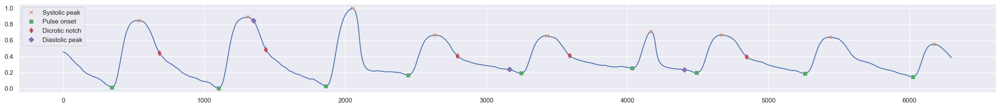

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

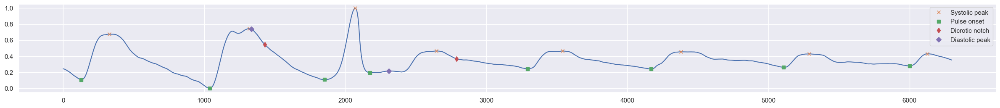

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

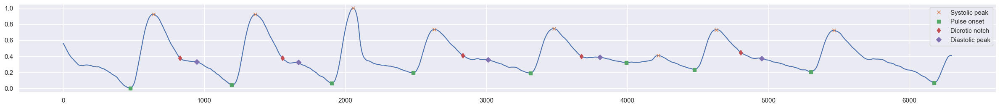

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

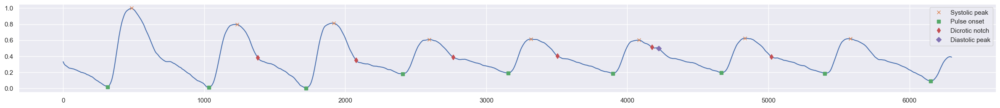

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

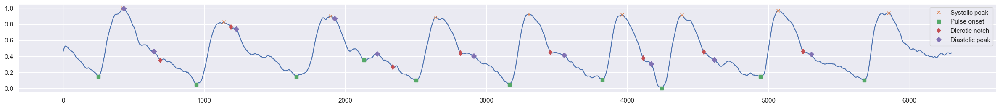

<Figure size 2000x1000 with 0 Axes>

<Figure size 2000x1000 with 0 Axes>

In [24]:
j = {}
error = 0 
signal_feature = {}
for key in all_dataframes.keys():
    try:
        data = all_dataframes[key]
        a= [] 
        for k in range(len(data)):
            k = (k*1000) / 1000
            a.append(k)
        data = data.to_frame().assign(time=a)
        data = data.rename(columns={data.columns[0]: 'PPG', data.columns[1]: 'time'})
        data['PPG'] = hp.filter_signal(data['PPG'], cutoff=[0.8,10], sample_rate=1000, order=1, filtertype='bandpass')
        combined_signal = data['PPG']
        combined_time = data['time']
        combined_signal = normalize(combined_signal)
        chosen_data = np.array(combined_signal)
        chosen_time = np.array(combined_time)
        PPG_Morphology = Finding_Morphology(chosen_data, prominence_factor = 0.3)
        morphology = PPG_Classification(chosen_data)
        morphology = signal_check(chosen_data, combined_time, morphology)
        fig = plt.figure(figsize=(30,6))
        ax = fig.add_subplot(211)
        plt.plot(chosen_time, chosen_data)
        plt.plot(chosen_time[PPG_Morphology[1]], chosen_data[PPG_Morphology[1]], "x", label = "Systolic peak")
        plt.plot(chosen_time[PPG_Morphology[0]], chosen_data[PPG_Morphology[0]], "s", label = "Pulse onset")
        plt.plot(chosen_time[PPG_Morphology[2]], chosen_data[PPG_Morphology[2]], "d", label = "Dicrotic notch")
        plt.plot(chosen_time[PPG_Morphology[3]], chosen_data[PPG_Morphology[3]], "D", label = "Diastolic peak")
        plt.legend(loc='best')
        a = anchoring(chosen_data, chosen_time, morphology, show = False)
        b = anchoring1(chosen_data, chosen_time, morphology, show = False)
        signal_feature.clear()
        signal_feature = feature_analysis(a, b)
        j[key] = signal_feature.copy()
    except Exception as e:
        print(f"An error occurred: {e}")
        error += 1
        continue


In [25]:
error

2

In [26]:
j

{100: {'pulse_time': 632.75,
  'time_delay': 198.25,
  'crest_time': 178.25,
  'time_to_dn': 278.75,
  'time_to_dp': 376.5,
  'time_from_dn_to_end': 354.0,
  'time_ratio': 0.6695965970681678,
  'pulse_wave_amplitude': 0.8290112234867292,
  'reflection_index': 0.5584691637630026,
  'dicrotic_notch_amplitude': 0.5985899017178347,
  'diastolic_peak_amplitude': 0.46448236299944284,
  'pulse_onset_time_variance': 264.1875,
  'pulse_onset_amplitude_variance': 0.011528314352653758,
  'systolic_peak_time_variance': 264.1875,
  'systolic_peak_amplitude_variance': 0.011528314352653755,
  'dicrotic_notch_time_variance': 3644.75,
  'dicrotic_notch_amplitude_variance': 0.028579151498276355,
  'diastolic_peak_time_variance': 7340.1875,
  'diastolic_peak_amplitude_variance': 0.017717882294986033},
 103: {'pulse_time': 953.0,
  'time_delay': 193.66666666666666,
  'crest_time': 158.33333333333334,
  'time_to_dn': 252.66666666666666,
  'time_to_dp': 352.0,
  'time_from_dn_to_end': 700.3333333333334,
  '

In [27]:
len(j)

217

In [28]:
len(all_dataframes)

219

## Since the features has been extracted we can move on to ML models

In [29]:
from scipy.stats import skew
from scipy.stats.mstats import winsorize
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split

In [30]:
excel_file = "C:/Users/Nicholas Sudiyanto G/Downloads/5459299/PPG-BP Database/Data File/PPG-BP dataset.xlsx"

In [31]:
df_ids = pd.read_excel(excel_file, sheet_name=sheet_name, header =1)
subject_ids = df_ids.iloc[1:, 1].dropna().astype(int).tolist()  # Extract valid subject IDs

In [32]:
df_ids

,Num.,subject_ID,Sex(M/F),Age(year),Height(cm),Weight(kg),Systolic Blood Pressure(mmHg),Diastolic Blood Pressure(mmHg),Heart Rate(b/m),BMI(kg/m^2),Hypertension,Diabetes,cerebral infarction,cerebrovascular disease
0,1,2,Female,45,152,63,161,89,97,27.268006,Stage 2 hypertension,NaN,NaN,NaN
1,2,3,Female,50,157,50,160,93,76,20.284799,Stage 2 hypertension,NaN,NaN,NaN
2,3,6,Female,47,150,47,101,71,79,20.888889,Normal,NaN,NaN,NaN
3,4,8,Male,45,172,65,136,93,87,21.971336,Prehypertension,NaN,NaN,NaN
4,5,9,Female,46,155,65,123,73,73,27.055151,Prehypertension,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
214,215,415,Male,24,180,70,111,70,77,21.604938,Normal,NaN,NaN,NaN
215,216,416,Female,25,156,47,93,57,79,19.312952,Normal,NaN,NaN,NaN
216,217,417,Male,25,176,55,120,69,72,17.755682,Prehypertension,NaN,NaN,NaN
217,218,418,Male,25,173,63,106,69,67,21.049818,Normal,NaN,NaN,NaN


In [33]:
flattened_data = []
for subject_id, features in j.items():
    features["subject_ID"] = subject_id  # Ensure subject_ID is a column
    flattened_data.append(features)

# Convert to DataFrame
dict_df = pd.DataFrame(flattened_data)

# Merge with original DataFrame
merged_df = df_ids.merge(dict_df, on="subject_ID", how="left")

# Replace missing values with NaN
merged_df.fillna(np.nan, inplace=True)

In [34]:
merged_df

,Num.,subject_ID,Sex(M/F),Age(year),Height(cm),Weight(kg),Systolic Blood Pressure(mmHg),Diastolic Blood Pressure(mmHg),Heart Rate(b/m),BMI(kg/m^2),...,dicrotic_notch_amplitude,diastolic_peak_amplitude,pulse_onset_time_variance,pulse_onset_amplitude_variance,systolic_peak_time_variance,systolic_peak_amplitude_variance,dicrotic_notch_time_variance,dicrotic_notch_amplitude_variance,diastolic_peak_time_variance,diastolic_peak_amplitude_variance
0,1,2,Female,45,152,63,161,89,97,27.268006,...,0.239357,0.164566,28.666667,0.000686,28.666667,0.000686,20.222222,0.000283,84.666667,0.000048
1,2,3,Female,50,157,50,160,93,76,20.284799,...,0.442780,0.349981,316.960000,0.000934,316.960000,0.000934,248.240000,0.001680,1752.160000,0.001674
2,3,6,Female,47,150,47,101,71,79,20.888889,...,0.439526,0.289879,63.500000,0.014027,63.500000,0.014027,2388.500000,0.015120,13361.000000,0.007028
3,4,8,Male,45,172,65,136,93,87,21.971336,...,0.331753,0.256052,800.750000,0.023829,800.750000,0.023829,492.250000,0.010758,381.250000,0.008030
4,5,9,Female,46,155,65,123,73,73,27.055151,...,0.437162,0.390752,1695.760000,0.003528,1695.760000,0.003528,1514.560000,0.028775,3101.440000,0.035065
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
214,215,415,Male,24,180,70,111,70,77,21.604938,...,0.244117,0.348313,13.555556,0.000187,13.555556,0.000187,4.666667,0.000242,10.888889,0.000233
215,216,416,Female,25,156,47,93,57,79,19.312952,...,0.320687,0.278565,13.888889,0.001432,13.888889,0.001432,280.916667,0.002297,449.888889,0.002599
216,217,417,Male,25,176,55,120,69,72,17.755682,...,0.262107,0.282809,5.918367,0.003661,5.918367,0.003661,977.836735,0.003598,208.000000,0.001334
217,218,418,Male,25,173,63,106,69,67,21.049818,...,0.389218,0.385590,4.666667,0.000697,4.666667,0.000697,554.666667,0.005544,6.888889,0.001764


In [35]:
df = merged_df

In [36]:
# Check for missing values & fill with median
print("Missing Values Before Handling:\n", df.isnull().sum())
for col in df.select_dtypes(include=[np.number]).columns:
    df[col].fillna(df[col].median(), inplace=True)

Missing Values Before Handling:
 Num.                                   0
subject_ID                             0
Sex(M/F)                               0
Age(year)                              0
Height(cm)                             0
Weight(kg)                             0
Systolic Blood Pressure(mmHg)          0
Diastolic Blood Pressure(mmHg)         0
Heart Rate(b/m)                        0
BMI(kg/m^2)                            0
Hypertension                           0
Diabetes                             181
cerebral infarction                  199
cerebrovascular disease              194
pulse_time                            31
time_delay                            31
crest_time                            31
time_to_dn                            31
time_to_dp                            31
time_from_dn_to_end                   31
time_ratio                            31
pulse_wave_amplitude                  31
reflection_index                      31
dicrotic_notch_amplitude

C:\Users\Nicholas Sudiyanto G\AppData\Local\Temp\ipykernel_30420\3562426695.py:4: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[col].fillna(df[col].median(), inplace=True)
C:\Users\Nicholas Sudiyanto G\AppData\Local\Temp\ipykernel_30420\3562426695.py:4: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always

In [38]:
# Drop unnecessary columns with too many missing values
drop_columns = ["Hypertension", "Diabetes", "cerebral infarction", "cerebrovascular disease","subject_ID"]
df = df.drop(columns=drop_columns, errors='ignore')

In [39]:
# Convert Categorical Variables (Sex to Numeric)
df["Sex(M/F)"] = df["Sex(M/F)"].map({"Male": 1, "Female": 0})

In [40]:
# Handle Outliers (Winsorization - Capping at 1%)
for col in df.select_dtypes(include=[np.number]).columns:
    df[col] = winsorize(df[col], limits=[0.01, 0.01])  # Capping top/bottom 1%

In [41]:
# Check skewness & normalize highly skewed features
skewed_features = df.select_dtypes(include=[np.number]).apply(lambda x: skew(x)).sort_values(ascending=False)
skewed_cols = skewed_features[abs(skewed_features) > 1].index
print("Highly Skewed Features:", skewed_cols.tolist())
for col in skewed_cols:
    df[col] = np.log1p(df[col])  # Log Transform to reduce skewness

Highly Skewed Features: ['systolic_peak_time_variance', 'pulse_onset_time_variance', 'diastolic_peak_time_variance', 'dicrotic_notch_amplitude_variance', 'diastolic_peak_amplitude_variance', 'dicrotic_notch_time_variance', 'time_to_dp', 'crest_time', 'systolic_peak_amplitude_variance', 'pulse_onset_amplitude_variance', 'dicrotic_notch_amplitude']


In [42]:
#️ Normalize Data (MinMax Scaling)
scaler = MinMaxScaler()
scaled_features = scaler.fit_transform(df.drop(columns=["Systolic Blood Pressure(mmHg)", "Diastolic Blood Pressure(mmHg)"]))
df_scaled = pd.DataFrame(scaled_features, columns=df.columns.drop(["Systolic Blood Pressure(mmHg)", "Diastolic Blood Pressure(mmHg)"]))

In [43]:
# Add target variables back
df_scaled["Systolic Blood Pressure(mmHg)"] = df["Systolic Blood Pressure(mmHg)"].values
df_scaled["Diastolic Blood Pressure(mmHg)"] = df["Diastolic Blood Pressure(mmHg)"].values

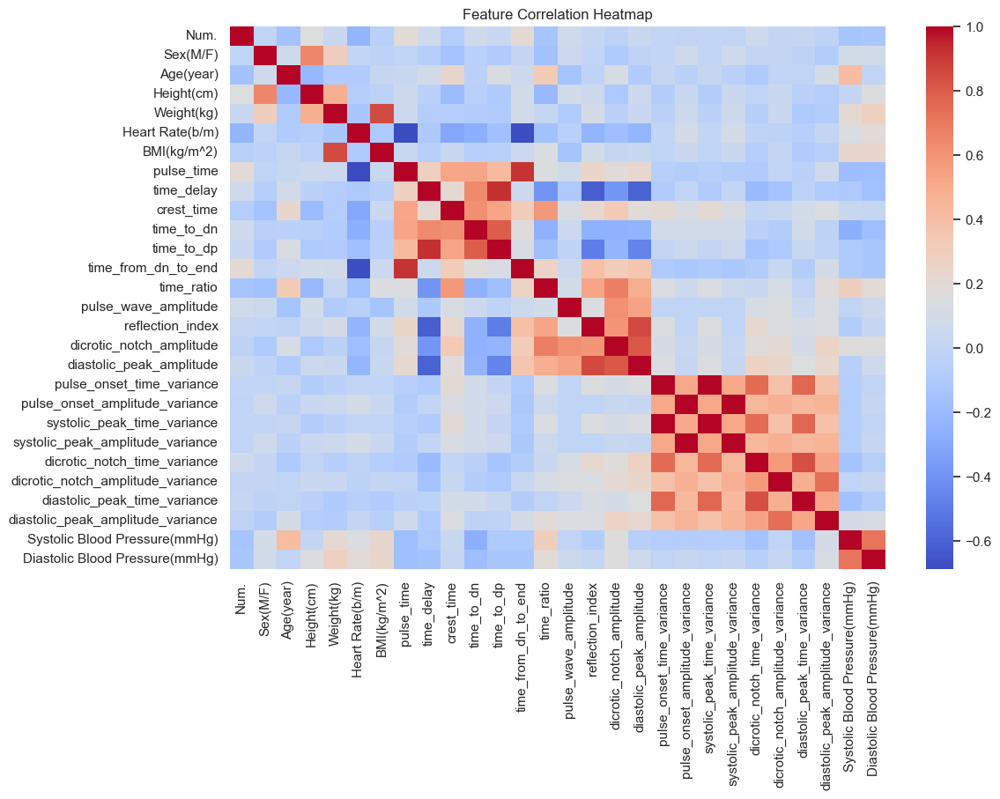

In [44]:
# Feature Correlation Analysis
plt.figure(figsize=(12, 8))
sb.heatmap(df_scaled.corr(), annot=False, cmap="coolwarm")
plt.title("Feature Correlation Heatmap")
plt.show()

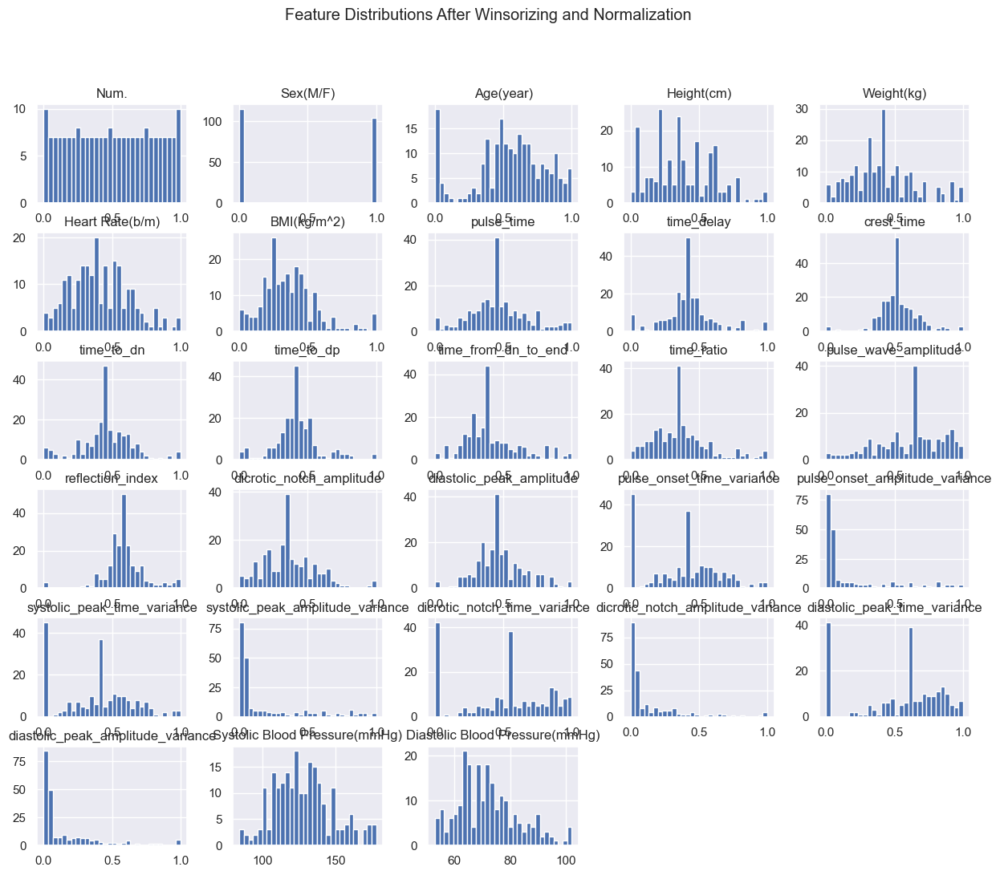

In [45]:
# Visualize Feature Distributions
df_scaled.hist(figsize=(15, 12), bins=30)
plt.suptitle("Feature Distributions After Winsorizing and Normalization")
plt.show()

In [46]:
# Train-Test Split
X = df_scaled.drop(columns=["Systolic Blood Pressure(mmHg)", "Diastolic Blood Pressure(mmHg)"])
y_sbp = df_scaled["Systolic Blood Pressure(mmHg)"]
y_dbp = df_scaled["Diastolic Blood Pressure(mmHg)"]

In [47]:
X_train, X_test, y_sbp_train, y_sbp_test = train_test_split(X, y_sbp, test_size=0.2, random_state=42)
X_train, X_test, y_dbp_train, y_dbp_test = train_test_split(X, y_dbp, test_size=0.2, random_state=42)

In [48]:
df_scaled.to_csv("processed_data.csv", index=False)

## Machine Learning Model

In [49]:
# As the baseline for the ML model, we will use the basic ML model(regression, randomforest, and XGBoost as the baseline comparison
# for our deep learning model
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error
from xgboost import XGBRegressor

In [50]:
# Define all 3 models
models = {
    "Linear Regression": LinearRegression(),
    "Random Forest": RandomForestRegressor(n_estimators=100, random_state=42),
    "XGBoost": XGBRegressor(objective='reg:squarederror', n_estimators=100, random_state=42)}

In [51]:
# Now we train, fit and compute the error. In our case, we use Mean absolute error and root mean squeared error as our loss function
results = {}
for model_name, model in models.items():
    model.fit(X_train, y_sbp_train)
    
    # Predictions
    y_train_pred = model.predict(X_train)
    y_test_pred = model.predict(X_test)
    
    # Compute Errors
    train_mae = mean_absolute_error(y_sbp_train, y_train_pred)
    test_mae = mean_absolute_error(y_sbp_test, y_test_pred)
    train_rmse = np.sqrt(mean_squared_error(y_sbp_train, y_train_pred))
    test_rmse = np.sqrt(mean_squared_error(y_sbp_test, y_test_pred))
    
    # Store Results
    results[model_name] = {
        "Train MAE": train_mae,
        "Test MAE": test_mae,
        "Train RMSE": train_rmse,
        "Test RMSE": test_rmse
    }

In [52]:
results

{'Linear Regression': {'Train MAE': 11.496461330109728,
  'Test MAE': 12.117420885552749,
  'Train RMSE': 14.742500886212094,
  'Test RMSE': 17.07077581790555},
 'Random Forest': {'Train MAE': 5.223542857142856,
  'Test MAE': 11.367045454545455,
  'Train RMSE': 6.675994778736296,
  'Test RMSE': 15.220404142884226},
 'XGBoost': {'Train MAE': 0.0005717250279017857,
  'Test MAE': 12.525640487670898,
  'Train RMSE': 0.0009510432106249859,
  'Test RMSE': 16.993428534783344}}

In [53]:
# Overfitting detcted (error test >> error train), we need to apply regularization to minimize 
from sklearn.linear_model import Ridge

In [54]:
models = {
    "Ridge Regression (L2)": Ridge(alpha=1.0),  # L2 Regularization
    "Random Forest": RandomForestRegressor(n_estimators=100, max_depth=7, random_state=42),  # Limit tree depth
    "XGBoost": XGBRegressor(objective='reg:squarederror', n_estimators=100, max_depth=5, reg_alpha=0.1, reg_lambda=1, random_state=42)} # L1 & L2 Regularization

In [55]:
results = {}
for model_name, model in models.items():
    model.fit(X_train, y_sbp_train)
    
    # Predictions
    y_train_pred = model.predict(X_train)
    y_test_pred = model.predict(X_test)
    
    # Compute Errors
    train_mae = mean_absolute_error(y_sbp_train, y_train_pred)
    test_mae = mean_absolute_error(y_sbp_test, y_test_pred)
    train_rmse = np.sqrt(mean_squared_error(y_sbp_train, y_train_pred))
    test_rmse = np.sqrt(mean_squared_error(y_sbp_test, y_test_pred))
    
    # Store Results
    results[model_name] = {
        "Train MAE": train_mae,
        "Test MAE": test_mae,
        "Train RMSE": train_rmse,
        "Test RMSE": test_rmse
    }

In [56]:
results

{'Ridge Regression (L2)': {'Train MAE': 11.822613869985206,
  'Test MAE': 11.877831943075767,
  'Train RMSE': 15.146046153960823,
  'Test RMSE': 15.691750497555518},
 'Random Forest': {'Train MAE': 6.674449342147867,
  'Test MAE': 11.4329658323483,
  'Train RMSE': 8.342341465636483,
  'Test RMSE': 15.366448294988324},
 'XGBoost': {'Train MAE': 0.01032318115234375,
  'Test MAE': 12.580937125466086,
  'Train RMSE': 0.017443932040444324,
  'Test RMSE': 16.569040164390877}}

In [57]:
#even when we introduce regularization, its still overfit lets try to increase the regularization parameters

In [58]:
# Convert results to DataFrame
results_df = pd.DataFrame(results).T
results_df.to_csv("baseline_results_with_regularization.csv", index=False)

In [59]:
#Hyperparameter Tuning for XGBoost (After Regularization)
from skopt import BayesSearchCV
param_space = {
    'n_estimators': (30, 150),
    'max_depth': (3, 7),
    'learning_rate': (0.01, 0.2),
    'reg_alpha': (0.01, 1.0),
    'reg_lambda': (1, 10)
}

bayes_search = BayesSearchCV(XGBRegressor(objective='reg:squarederror', random_state=42), param_space, n_iter=30, cv=3, scoring='neg_mean_absolute_error', verbose=1, n_jobs=-1)
bayes_search.fit(X_train, y_sbp_train)

# Best parameters & score
best_params = bayes_search.best_params_
best_score = -bayes_search.best_score_

# Save Best Model Performance
best_model_performance = {
    "Best Params": best_params,
    "Best score": best_score
}

Fitting 3 folds for each of 1 candidates, totalling 3 fits
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Fitting 3 folds for each of 1 candidates, totalling 3 fi

In [60]:
best_model_performance

{'Best Params': OrderedDict([('learning_rate', 0.08897679857831363),
              ('max_depth', 4),
              ('n_estimators', 150),
              ('reg_alpha', 1.0),
              ('reg_lambda', 1)]),
 'Best score': 14.13797598518685}

In [61]:
models = XGBRegressor(objective='reg:squarederror', n_estimators=30, max_depth=3, reg_alpha=1, reg_lambda=2, random_state=42, learning_rate = 0.2) # L1 & L2 Regularization

In [62]:
models.fit(X_train, y_sbp_train)
# Predictions
y_train_pred = models.predict(X_train)
y_test_pred = models.predict(X_test)
    
# Compute Errors
train_mae = mean_absolute_error(y_sbp_train, y_train_pred)
test_mae = mean_absolute_error(y_sbp_test, y_test_pred)
train_rmse = np.sqrt(mean_squared_error(y_sbp_train, y_train_pred))
test_rmse = np.sqrt(mean_squared_error(y_sbp_test, y_test_pred))

results = {}
# Store Results
results[model_name] = {
    "Train MAE": train_mae,
    "Test MAE": test_mae,
    "Train RMSE": train_rmse,
    "Test RMSE": test_rmse
}
results

{'XGBoost': {'Train MAE': 5.949719892229353,
  'Test MAE': 12.229325554587625,
  'Train RMSE': 7.84404369473785,
  'Test RMSE': 15.721545667373812}}

In [63]:
# Since the overfit quite high lets try to tune it again 

In [64]:
param_space = {
    'n_estimators': (20, 50),
    'max_depth': (2, 4),
    'learning_rate': (0.05, 0.1),
    'reg_alpha': (0.5, 1.5),
    'reg_lambda': (5, 10)
}

bayes_search = BayesSearchCV(XGBRegressor(objective='reg:squarederror', random_state=42), param_space, n_iter=20, cv=3, scoring='neg_mean_absolute_error', verbose=1, n_jobs=-1)
bayes_search.fit(X_train, y_sbp_train)

# Best parameters & score
best_params = bayes_search.best_params_
best_score = -bayes_search.best_score_

# Save Best Model Performance
best_model_performance = {
    "Best Params": best_params,
    "Best score": best_score}
best_model_performance

Fitting 3 folds for each of 1 candidates, totalling 3 fits
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Fitting 3 folds for each of 1 candidates, totalling 3 fits
Fitting 3 folds for each of 1 candidates, totalling 3 fi

{'Best Params': OrderedDict([('learning_rate', 0.1),
              ('max_depth', 3),
              ('n_estimators', 25),
              ('reg_alpha', 0.5),
              ('reg_lambda', 5)]),
 'Best score': 14.311143222246258}

In [65]:
models = XGBRegressor(objective='reg:squarederror', n_estimators=48, max_depth=3, reg_alpha=1.5, reg_lambda=9, random_state=42, learning_rate = 0.1) # L1 & L2 Regularization

In [66]:
models.fit(X_train, y_sbp_train)
# Predictions
y_train_pred = models.predict(X_train)
y_test_pred = models.predict(X_test)
    
# Compute Errors
train_mae = mean_absolute_error(y_sbp_train, y_train_pred)
test_mae = mean_absolute_error(y_sbp_test, y_test_pred)
train_rmse = np.sqrt(mean_squared_error(y_sbp_train, y_train_pred))
test_rmse = np.sqrt(mean_squared_error(y_sbp_test, y_test_pred))

results = {}
# Store Results
results[model_name] = {
    "Train MAE": train_mae,
    "Test MAE": test_mae,
    "Train RMSE": train_rmse,
    "Test RMSE": test_rmse
}
results

{'XGBoost': {'Train MAE': 7.392537536621094,
  'Test MAE': 11.7302509654652,
  'Train RMSE': 9.778917586449026,
  'Test RMSE': 15.647353425888916}}

In [67]:
# Its better but not much imrpovement could be done with this method, thus either we try to eliminate some features or
# we try to do hyperparameter tuning using optuna once again

In [68]:
import optuna
# Define the Optuna optimization function
def objective(trial):
    params = {
        'objective': 'reg:squarederror',
        'learning_rate': trial.suggest_loguniform('learning_rate', 0.01, 0.3),
        'n_estimators': trial.suggest_int('n_estimators', 30, 100),
        'max_depth': trial.suggest_int('max_depth', 2, 6),
        'reg_alpha': trial.suggest_loguniform('reg_alpha', 0.1, 5.0),
        'reg_lambda': trial.suggest_loguniform('reg_lambda', 1.0, 15.0),
        'subsample': trial.suggest_uniform('subsample', 0.5, 1.0),
    }
    # Train model
    model = XGBRegressor(**params)
    model.fit(X_train, y_sbp_train)

    # Predict and evaluate
    y_pred = model.predict(X_test)
    rmse = mean_squared_error(y_sbp_test, y_pred, squared=False)
    
    return rmse  # Optuna will minimize RMSE

# Run Optuna optimization
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=30)

# Print best parameters
print("Best Parameters:", study.best_params)
print("Best RMSE:", study.best_value)


[I 2025-03-02 04:42:51,186] A new study created in memory with name: no-name-740d8b7d-b8a0-4101-9cfa-125d6478203e
C:\Users\Nicholas Sudiyanto G\AppData\Local\Temp\ipykernel_30420\2083067292.py:6: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'learning_rate': trial.suggest_loguniform('learning_rate', 0.01, 0.3),
C:\Users\Nicholas Sudiyanto G\AppData\Local\Temp\ipykernel_30420\2083067292.py:9: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  'reg_alpha': trial.suggest_loguniform('reg_alpha', 0.1, 5.0),
C:\Users\Nicholas Sudiyanto G\AppData\Local\Temp\ipykernel_30420\2083067292.py:10: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be remove

Best Parameters: {'learning_rate': 0.06370390454496296, 'n_estimators': 56, 'max_depth': 2, 'reg_alpha': 0.1762993338070119, 'reg_lambda': 3.2392869029642393, 'subsample': 0.5044161168071386}
Best RMSE: 14.790422461171335


In [69]:
models = XGBRegressor(objective='reg:squarederror', n_estimators=55, max_depth=2, reg_alpha=0.10006288778623545, reg_lambda=1.0023705343124754, random_state=42, learning_rate = 0.15538051760233657) # L1 & L2 Regularization

In [70]:
models.fit(X_train, y_sbp_train)
# Predictions
y_train_pred = models.predict(X_train)
y_test_pred = models.predict(X_test)
    
# Compute Errors
train_mae = mean_absolute_error(y_sbp_train, y_train_pred)
test_mae = mean_absolute_error(y_sbp_test, y_test_pred)
train_rmse = np.sqrt(mean_squared_error(y_sbp_train, y_train_pred))
test_rmse = np.sqrt(mean_squared_error(y_sbp_test, y_test_pred))

results = {}
# Store Results
results[model_name] = {
    "Train MAE": train_mae,
    "Test MAE": test_mae,
    "Train RMSE": train_rmse,
    "Test RMSE": test_rmse
}
results

{'XGBoost': {'Train MAE': 7.406168169294085,
  'Test MAE': 12.196868376298385,
  'Train RMSE': 9.353605926414081,
  'Test RMSE': 15.696830675964327}}

In [71]:
# Not goog, so we know try to eliminate not so important features

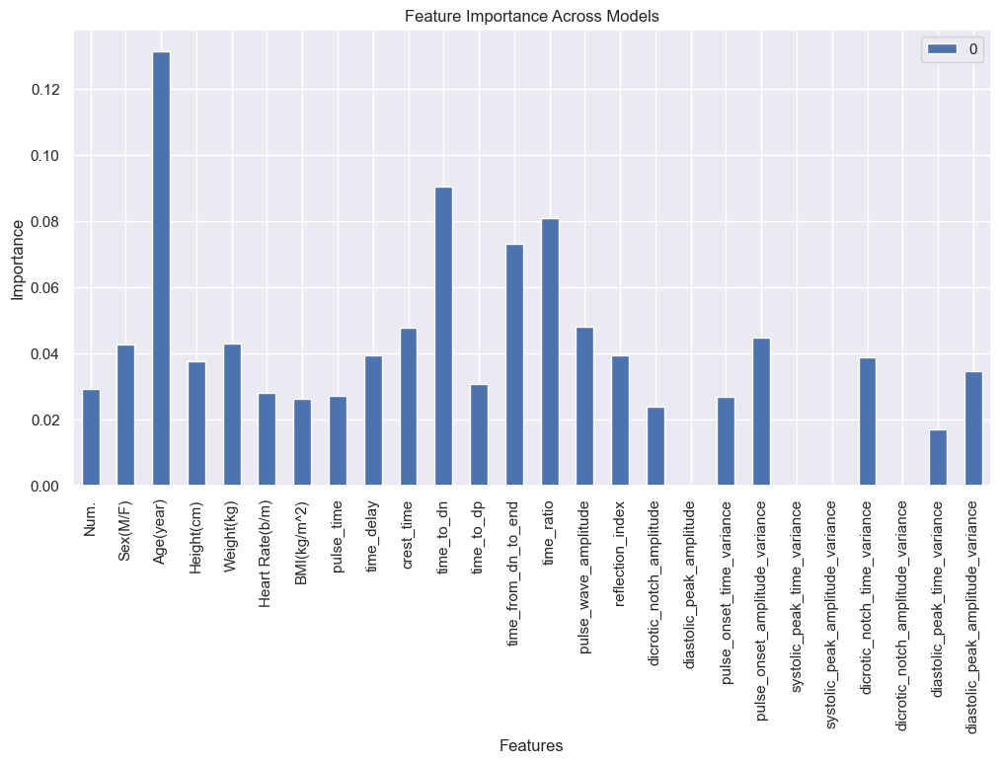

In [72]:
feature_names = X_train.columns
# Extract feature importance
feature_importance =  models.feature_importances_
#Convert to DataFrame
importance_df = pd.DataFrame(feature_importance, index=feature_names)

# Plot feature importance
importance_df.plot(kind="bar", figsize=(12,6))
plt.title("Feature Importance Across Models")
plt.xlabel("Features")
plt.ylabel("Importance")
plt.legend()
plt.show()

In [87]:
# Set threshold value
threshold = 0.04  # Change this as needed

# Select features above the threshold
selected_features = importance_df[importance_df > threshold]
selected_features.dropna(inplace=True)
selected_features

,0
Sex(M/F),0.042699
Age(year),0.131533
Weight(kg),0.043009
crest_time,0.047784
time_to_dn,0.090411
time_from_dn_to_end,0.073150
time_ratio,0.080982
pulse_wave_amplitude,0.047957
pulse_onset_amplitude_variance,0.044549


In [88]:
X_train, X_test, y_sbp_train, y_sbp_test = train_test_split(X[selected_features.index.tolist()], y_sbp, test_size=0.2, random_state=42)
# X_train, X_test, y_dbp_train, y_dbp_test = train_test_split(X[selected_features], y_dbp, test_size=0.2, random_state=42)

In [89]:
print(X_train.shape)
print(X_test.shape)
print(y_sbp_train.shape)
print(y_sbp_test.shape)

(175, 9)
(44, 9)
(175,)
(44,)


In [100]:
models = XGBRegressor(objective='reg:squarederror', n_estimators=60, max_depth=4, reg_alpha=3, reg_lambda=20, random_state=42, learning_rate = 0.1) # L1 & L2 Regularization

In [101]:
models.fit(X_train, y_sbp_train)
# Predictions
y_train_pred = models.predict(X_train)
y_test_pred = models.predict(X_test)
    
# Compute Errors
train_mae = mean_absolute_error(y_sbp_train, y_train_pred)
test_mae = mean_absolute_error(y_sbp_test, y_test_pred)
train_rmse = np.sqrt(mean_squared_error(y_sbp_train, y_train_pred))
test_rmse = np.sqrt(mean_squared_error(y_sbp_test, y_test_pred))

results = {}
# Store Results
results[model_name] = {
    "Train MAE": train_mae,
    "Test MAE": test_mae,
    "Train RMSE": train_rmse,
    "Test RMSE": test_rmse
}
results

{'XGBoost': {'Train MAE': 7.640561349051339,
  'Test MAE': 12.34739875793457,
  'Train RMSE': 10.092253245325153,
  'Test RMSE': 15.840790419929156}}

In [102]:
#it seems there is still overfitting, but lets move on to Deep Learning 

## Deep Learning Model

### Multi-Layered Perceptron (MLP) or NN

In [103]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, BatchNormalization
from tensorflow.keras.optimizers import Adam
from sklearn.model_selection import train_test_split

In [122]:
x = X

In [123]:
X_train, X_test, y_sbp_train, y_sbp_test = train_test_split(x, y_sbp, test_size=0.2, random_state=42)
X_train, X_test, y_dbp_train, y_dbp_test = train_test_split(x, y_dbp, test_size=0.2, random_state=42)

In [124]:
print(X_train.shape)
print(y_sbp_train.shape)


(175, 26)
(175,)


In [107]:
# Define MLP Model
mlp_model = Sequential([
    Dense(128, activation='relu', input_shape=(X_train.shape[1],)),
    BatchNormalization(),
    Dropout(0.2),
    Dense(64, activation='relu'),
    BatchNormalization(),
    Dropout(0.2),
    Dense(1)  # Regression output
])

C:\Users\Nicholas Sudiyanto G\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [108]:
# Compile the model
mlp_model.compile(optimizer=Adam(learning_rate=0.01), loss='mse', metrics=['mae'])

In [109]:
# Train the model
mlp_history = mlp_model.fit(X_train, y_sbp_train,
    epochs=50,  # Initial training
    batch_size=32,
    validation_data=(X_test, y_sbp_test),
    verbose=1
)

Epoch 1/50
6/6 ━━━━━━━━━━━━━━━━━━━━ 4s 99ms/step - loss: 17073.0098 - mae: 128.9585 - val_loss: 16193.8564 - val_mae: 125.8997
Epoch 2/50
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 16865.2148 - mae: 128.3744 - val_loss: 15873.4971 - val_mae: 124.6410
Epoch 3/50
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 15921.5713 - mae: 124.7175 - val_loss: 15327.4492 - val_mae: 122.4536
Epoch 4/50
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 15795.1055 - mae: 124.5609 - val_loss: 14569.5146 - val_mae: 119.3520
Epoch 5/50
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 15322.2432 - mae: 122.6780 - val_loss: 13668.9521 - val_mae: 115.5771
Epoch 6/50
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 14755.1660 - mae: 120.4727 - val_loss: 12932.2041 - val_mae: 112.4013
Epoch 7/50
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 13672.9072 - mae: 115.8295 - val_loss: 12309.5654 - val_mae: 109.6242
Epoch 8/50
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 12738.7393 - mae: 111.7310 - val_loss: 11238.9922 - va

In [110]:
y_pred = mlp_model.predict(X_test)
mae = mean_absolute_error(y_sbp_test, y_pred)
rmse = mean_squared_error(y_sbp_test, y_pred, squared=False)

print(f"MLP Model Performance:\n MAE: {mae:.4f} \n RMSE: {rmse:.4f}")

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step
MLP Model Performance:
 MAE: 12.3395 
 RMSE: 16.6785


C:\Users\Nicholas Sudiyanto G\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


In [113]:
#now we calculated the feature importance
from sklearn.inspection import permutation_importance

# Compute permutation importance
perm_importance = permutation_importance(mlp_model, X_test, y_sbp_test, scoring="neg_mean_squared_error")

# Convert to DataFrame for easy visualization
feature_importance_df = pd.DataFrame({
    "Feature": X.columns,
    "Importance": perm_importance.importances_mean
}).sort_values(by="Importance", ascending=False)

print(feature_importance_df)

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
2/2 ━━━━━━━━

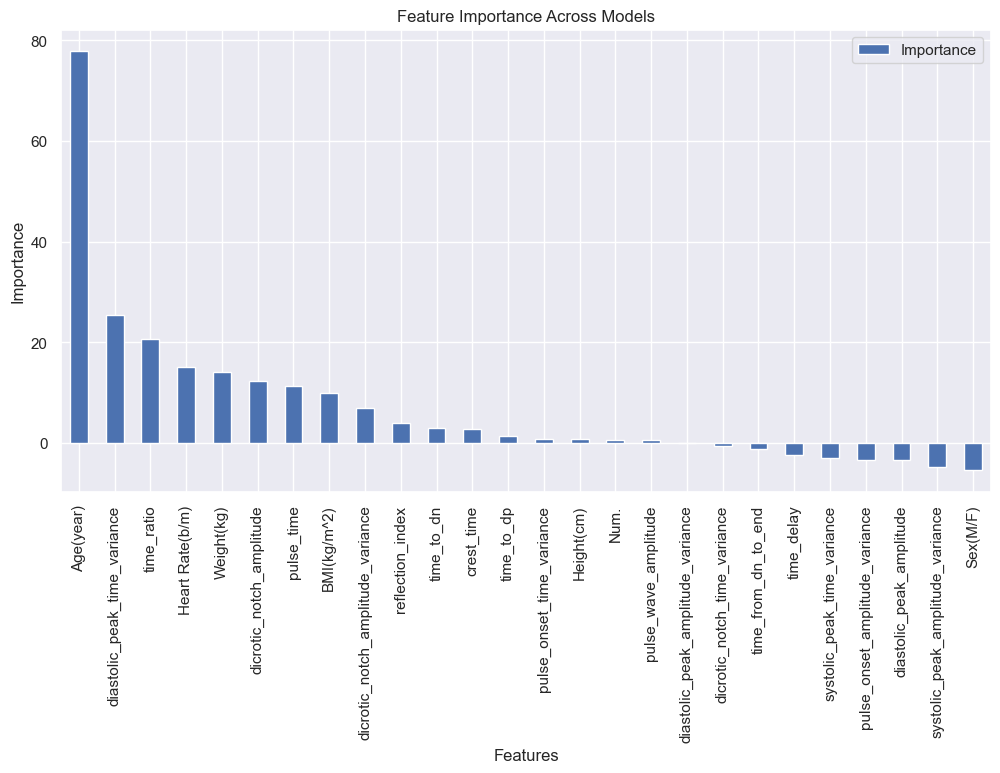

In [116]:
# Plot feature importance
feature_importance_df.plot(x = 'Feature', y= 'Importance', kind="bar", figsize=(12,6))
plt.title("Feature Importance Across Models")
plt.xlabel("Features")
plt.ylabel("Importance")
plt.legend()
plt.show()

In [121]:
# Set threshold value
threshold = 3  # Change this as needed

# Select features above the threshold
selected_features = feature_importance_df[feature_importance_df['Importance'] > threshold]
selected_features.dropna(inplace=True)
selected_features = selected_features['Feature'].tolist()
selected_features

C:\Users\Nicholas Sudiyanto G\AppData\Local\Temp\ipykernel_30420\3993545830.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selected_features.dropna(inplace=True)


['Age(year)',
 'diastolic_peak_time_variance',
 'time_ratio',
 'Heart Rate(b/m)',
 'Weight(kg)',
 'dicrotic_notch_amplitude',
 'pulse_time',
 'BMI(kg/m^2)',
 'dicrotic_notch_amplitude_variance',
 'reflection_index']

In [125]:
X_train, X_test, y_sbp_train, y_sbp_test = train_test_split(x[selected_features], y_sbp, test_size=0.2, random_state=42)

In [126]:
print(X_train.shape)
print(y_sbp_train.shape)
print(X_test.shape)
print(y_sbp_test.shape)

(175, 10)
(175,)
(44, 10)
(44,)


In [129]:
#Hyperparameter tuning
from tensorflow.keras.callbacks import EarlyStopping
# Tuned MLP Model
mlp_model = Sequential([
    Dense(256, activation='relu', input_shape=(X_train.shape[1],)),
    BatchNormalization(),
    Dropout(0.3),
    Dense(128, activation='relu'),
    BatchNormalization(),
    Dropout(0.3),
    Dense(64, activation='relu'),
    BatchNormalization(),
    Dropout(0.3),
    Dense(1)  # Regression output
])

# Compile the model
mlp_model.compile(optimizer=Adam(learning_rate=0.01), loss='mse', metrics=['mae'])

# Add Early Stopping
early_stop = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

# Train the model
mlp_history = mlp_model.fit(
    X_train, y_sbp_train,
    epochs=100,  # Increased epochs
    batch_size=32,
    validation_data=(X_test, y_sbp_test),
    callbacks=[early_stop],
    verbose=1
)

Epoch 1/100
6/6 ━━━━━━━━━━━━━━━━━━━━ 4s 90ms/step - loss: 16620.7559 - mae: 127.3919 - val_loss: 16210.9746 - val_mae: 125.9737
Epoch 2/100
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 16965.1797 - mae: 128.6916 - val_loss: 15948.6787 - val_mae: 124.9603
Epoch 3/100
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 16062.5605 - mae: 125.4082 - val_loss: 15535.7383 - val_mae: 123.3377
Epoch 4/100
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 15784.1904 - mae: 124.2419 - val_loss: 14838.2773 - val_mae: 120.5342
Epoch 5/100
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 15599.8486 - mae: 123.6376 - val_loss: 14137.8965 - val_mae: 117.6528
Epoch 6/100
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 15164.1133 - mae: 121.8279 - val_loss: 12931.4746 - val_mae: 112.4828
Epoch 7/100
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 14109.6641 - mae: 117.6962 - val_loss: 11633.3154 - val_mae: 106.5747
Epoch 8/100
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 13224.5977 - mae: 113.7267 - val_loss: 10180.6

In [130]:
# Compute Errors
y_pred = mlp_model.predict(X_test)
mae = mean_absolute_error(y_sbp_test, y_pred)
rmse = mean_squared_error(y_sbp_test, y_pred, squared=False)

print(f"Tuned MLP Model Performance:\n MAE: {mae:.4f} \n RMSE: {rmse:.4f}")

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
Tuned MLP Model Performance:
 MAE: 12.4081 
 RMSE: 16.8164


C:\Users\Nicholas Sudiyanto G\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


In [131]:
from keras import regularizers
mlp_model = Sequential([
    Dense(512, activation='relu', input_shape=(X_train.shape[1],)),
    BatchNormalization(),
    Dropout(0.3),
    Dense(256, activation='relu', kernel_regularizer=regularizers.L1L2(l1=1e-5, l2=1e-4)),
    BatchNormalization(),
    Dropout(0.3),
    Dense(128, activation='relu', kernel_regularizer=regularizers.L1L2(l1=1e-5, l2=1e-4)),
    BatchNormalization(),
    Dropout(0.3),
    Dense(64, activation='relu', kernel_regularizer=regularizers.L1L2(l1=1e-5, l2=1e-4)),
    BatchNormalization(),
    Dropout(0.3),
    Dense(1)  # Regression output
])

# Compile the model
mlp_model.compile(optimizer=Adam(learning_rate=0.01), loss='mse', metrics=['mae'])

# Add Early Stopping
early_stop = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

# Train the model
mlp_history = mlp_model.fit(
    X_train, y_sbp_train,
    epochs=100,  # Increased epochs
    batch_size=32,
    validation_data=(X_test, y_sbp_test),
    callbacks=[early_stop],
    verbose=1
)

C:\Users\Nicholas Sudiyanto G\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/100
6/6 ━━━━━━━━━━━━━━━━━━━━ 7s 123ms/step - loss: 16638.5566 - mae: 127.3627 - val_loss: 16204.4434 - val_mae: 125.9430
Epoch 2/100
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - loss: 17207.2852 - mae: 129.6705 - val_loss: 16000.3428 - val_mae: 125.1630
Epoch 3/100
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 16291.0322 - mae: 126.0970 - val_loss: 15440.3242 - val_mae: 122.9575
Epoch 4/100
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - loss: 16040.9854 - mae: 125.4239 - val_loss: 14619.1621 - val_mae: 119.6376
Epoch 5/100
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 15849.3281 - mae: 124.6744 - val_loss: 13487.4033 - val_mae: 114.9228
Epoch 6/100
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - loss: 15252.4385 - mae: 122.3397 - val_loss: 12495.0566 - val_mae: 110.5891
Epoch 7/100
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 13699.2803 - mae: 115.9737 - val_loss: 11981.3535 - val_mae: 108.1355
Epoch 8/100
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 13099.2881 - mae: 113.2099 - val_loss: 11848.

In [132]:
# Compute Errors
y_pred = mlp_model.predict(X_test)
mae = mean_absolute_error(y_sbp_test, y_pred)
rmse = mean_squared_error(y_sbp_test, y_pred, squared=False)

print(f"Tuned MLP Model Performance:\n MAE: {mae:.4f} \n RMSE: {rmse:.4f}")

1/2 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/stepWARNING:tensorflow:5 out of the last 529 calls to <function TensorFlowTrainer.make_predict_function.<locals>.one_step_on_data_distributed at 0x0000020B1AB5D260> triggered tf.function retracing. Tracing is expensive and the excessive number of tracings could be due to (1) creating @tf.function repeatedly in a loop, (2) passing tensors with different shapes, (3) passing Python objects instead of tensors. For (1), please define your @tf.function outside of the loop. For (2), @tf.function has reduce_retracing=True option that can avoid unnecessary retracing. For (3), please refer to https://www.tensorflow.org/guide/function#controlling_retracing and https://www.tensorflow.org/api_docs/python/tf/function for  more details.
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
Tuned MLP Model Performance:
 MAE: 11.0337 
 RMSE: 14.2229


C:\Users\Nicholas Sudiyanto G\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


In [250]:
# essentially, since no imrpovement was seen, we continue with LSTM

### LSTM Implementation

In [133]:
from tensorflow.keras.layers import LSTM
from sklearn.preprocessing import StandardScaler

In [134]:
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
X_scaled

array([[-1.69377642, -0.95097204, -0.77153695, ..., -0.62765124,
        -0.41660293, -0.67491603],
       [-1.69377642, -0.95097204, -0.45488292, ..., -0.49053961,
         0.49587532, -0.54948021],
       [-1.69377642, -0.95097204, -0.64487534, ...,  0.81828384,
         1.1097925 , -0.13769266],
       ...,
       [ 1.69377642,  1.05155562, -2.03815309, ..., -0.30268636,
        -0.1470136 , -0.57563384],
       [ 1.69377642,  1.05155562, -2.03815309, ..., -0.11249675,
        -1.13752923, -0.54250013],
       [ 1.69377642,  1.05155562, -2.1014839 , ..., -0.57478813,
        -0.55470012, -0.6258231 ]])

In [136]:
X_train, X_test, y_sbp_train, y_sbp_test = train_test_split(X_scaled, y_sbp, test_size=0.2, random_state=42)

# Reshape input for LSTM (samples, timesteps, features)
X_train_lstm = X_train.reshape((X_train.shape[0], 1, X_train.shape[1]))
X_test_lstm = X_test.reshape((X_test.shape[0], 1, X_test.shape[1]))

# Define LSTM Model
lstm_model = Sequential([
    LSTM(128, return_sequences=True, input_shape=(1, X_train.shape[1])),
    Dropout(0.2),
    LSTM(64, return_sequences=False),
    Dropout(0.2),
    Dense(1)  # Regression output
])

# Compile the model
lstm_model.compile(optimizer=Adam(learning_rate=0.01), loss='mse', metrics=['mae'])

# Add Early Stopping
early_stop = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

# Train the model
lstm_history = lstm_model.fit(
    X_train_lstm, y_sbp_train,
    epochs=100,
    batch_size=32,
    validation_data=(X_test_lstm, y_sbp_test),
    callbacks=[early_stop],
    verbose=1
)

# Compute Errors
y_pred = lstm_model.predict(X_test_lstm)
mae = mean_absolute_error(y_sbp_test, y_pred)
rmse = mean_squared_error(y_sbp_test, y_pred, squared=False)

print(f"LSTM Model Performance:\n MAE: {mae:.4f} \n RMSE: {rmse:.4f}")

C:\Users\Nicholas Sudiyanto G\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 1/100
6/6 ━━━━━━━━━━━━━━━━━━━━ 6s 209ms/step - loss: 16950.2930 - mae: 128.6408 - val_loss: 16239.0537 - val_mae: 126.0984
Epoch 2/100
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 16981.2129 - mae: 128.7134 - val_loss: 15305.0625 - val_mae: 122.3963
Epoch 3/100
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 15174.6035 - mae: 121.5742 - val_loss: 13687.5459 - val_mae: 115.5484
Epoch 4/100
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 13542.2305 - mae: 114.7367 - val_loss: 12326.9209 - val_mae: 109.4765
Epoch 5/100
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - loss: 12519.9922 - mae: 110.1956 - val_loss: 11388.2822 - val_mae: 105.0977
Epoch 6/100
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 11729.4082 - mae: 106.3931 - val_loss: 10609.4033 - val_mae: 101.3205
Epoch 7/100
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - loss: 10845.9668 - mae: 102.1182 - val_loss: 9896.8896 - val_mae: 97.7388
Epoch 8/100
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 10063.2686 - mae: 98.1677 - val_loss: 9234.6162

C:\Users\Nicholas Sudiyanto G\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


In [141]:
#Optimizing LSTM
from tensorflow.keras.layers import  Bidirectional, LayerNormalization
# Reshape input for LSTM (timesteps > 1)
TIME_STEPS = 5  # Use last 5 readings

def reshape_lstm_data(X, time_steps):
    X_reshaped = []
    for i in range(len(X) - time_steps):
        X_reshaped.append(X[i:i + time_steps])
    return np.array(X_reshaped)

# Reshape for sequential learning
X_train_lstm = reshape_lstm_data(X_train, TIME_STEPS)
X_test_lstm = reshape_lstm_data(X_test, TIME_STEPS)

y_train_lstm = y_sbp_train[TIME_STEPS:]  # Shift target to match sequence
y_test_lstm = y_sbp_test[TIME_STEPS:]

# Define Optimized LSTM Model
lstm_model = Sequential([
    Bidirectional(LSTM(128, return_sequences=True, input_shape=(TIME_STEPS, X_train.shape[1]))),
    Dropout(0.3),
    
    LayerNormalization(),  # Normalize activations
    
    LSTM(64, return_sequences=True),
    Dropout(0.3),
    
    LSTM(32, return_sequences=False),
    Dropout(0.2),
    
    Dense(1)  # Output layer for regression
])

# Compile the model
lstm_model.compile(
    optimizer=Adam(learning_rate=0.01),  # Lower learning rate
    loss=tf.keras.losses.Huber(),  # More robust loss
    metrics=['mae']
)

# Early stopping to prevent overfitting
early_stop = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

# Train the model
lstm_history = lstm_model.fit(
    X_train_lstm, y_train_lstm,
    epochs=150,
    batch_size=64,  # Larger batch size for stability
    validation_data=(X_test_lstm, y_test_lstm),
    callbacks=[early_stop],
    verbose=1
)

# Compute Errors
y_pred = lstm_model.predict(X_test_lstm)
mae = mean_absolute_error(y_test_lstm, y_pred)
rmse = mean_squared_error(y_test_lstm, y_pred, squared=False)

print(f"Optimized LSTM Performance:\n MAE: {mae:.4f} \n RMSE: {rmse:.4f}")


Epoch 1/150


C:\Users\Nicholas Sudiyanto G\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


3/3 ━━━━━━━━━━━━━━━━━━━━ 12s 582ms/step - loss: 126.7662 - mae: 127.2662 - val_loss: 121.5452 - val_mae: 122.0452
Epoch 2/150
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - loss: 122.9053 - mae: 123.4053 - val_loss: 118.3961 - val_mae: 118.8961
Epoch 3/150
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step - loss: 119.6862 - mae: 120.1862 - val_loss: 116.9990 - val_mae: 117.4990
Epoch 4/150
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - loss: 119.3156 - mae: 119.8156 - val_loss: 115.9325 - val_mae: 116.4325
Epoch 5/150
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - loss: 118.1835 - mae: 118.6835 - val_loss: 114.9020 - val_mae: 115.4020
Epoch 6/150
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - loss: 115.6212 - mae: 116.1212 - val_loss: 113.8623 - val_mae: 114.3623
Epoch 7/150
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step - loss: 115.2538 - mae: 115.7538 - val_loss: 112.8148 - val_mae: 113.3148
Epoch 8/150
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - loss: 114.1842 - mae: 114.6842 - val_loss: 111.7637 - val_mae: 112.2637
Epoch 9/150
3/3 ━━

C:\Users\Nicholas Sudiyanto G\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


In [142]:

# Creating the performance data
data = {
    "Model": ["Optimized LSTM", "Tuned MLP", "XGBoost"],
    "MAE": [13.0358, 11.0337, 12.3474],
    "RMSE": [17.2745, 14.2229, 15.8408]
}

# Creating a DataFrame
df = pd.DataFrame(data)

# Display the table
display(df)

,Model,MAE,RMSE
0,Optimized LSTM,13.0358,17.2745
1,Tuned MLP,11.0337,14.2229
2,XGBoost,12.3474,15.8408


THerefore, we will used tuned MLP 

In [256]:
from tensorflow.keras.layers import Conv1D, MaxPooling1D